# Clustering of imaging data

In [1]:
import numpy as np                     # scientific computing toolkit
import pandas as pd                    # data analysis toolkit
import scanpy as sc                    # scanpy is referred to with sc.***
import matplotlib.pyplot as plt        # Matplotlib is referred to with plt.***
from sklearn import preprocessing
from scipy import stats
import seaborn as sns
import math

sc.settings.verbosity = 0              # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()            # check if all needed versions are installed and up to date

scanpy==1.4.6 anndata==0.7.1 umap==0.3.10 numpy==1.18.1 scipy==1.4.1 pandas==0.25.3 scikit-learn==0.22.2 statsmodels==0.11.1 python-igraph==0.8.0


In [75]:
sc.settings.set_figure_params(dpi=80, dpi_save=500, color_map='viridis')

## Import and preprocessing:

#### Read the files for channels, FL_values and distances generated in ImageJ as pandas DataFrames:

In [3]:
data=pd.read_csv('./data/FL_values.csv',)
channels=pd.read_csv('./data/channels.csv')
gatings=pd.read_csv('./data/gatings.csv',sep=';')
gatings=gatings.fillna(0).astype(int)
gatings=gatings-1
gatings=gatings.astype(str)
cellnumber=int(data.shape[0]/channels.shape[0])

/Users/Sebastian/miniconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3063: DtypeWarning: Columns (23,24) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


#### Generate a matrix with the mean intensity values for each channel listed in additional columns and reshape the DataFrame:

In [4]:
matrix=pd.DataFrame(data[:cellnumber])
for i in range(0,channels.shape[0]):
    matrix[str(channels.iloc[i,0])]=0.000
    matrix[str(channels.iloc[i,0])][:cellnumber]=data.Mean[i*cellnumber:(i+1)*cellnumber]

/Users/Sebastian/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.


In [5]:
#Drop columns which will not be used in the adata object and replace NaN with a 0
matrix.fillna(0,inplace=True)
matrix_new = matrix.drop(matrix.iloc[:, 0:35], axis=1)
matrix.rename(columns={'Circ.':'Circularity'}, inplace=True)
matrix_new = matrix_new[matrix_new.columns.drop(list(matrix_new.filter(regex='min_Dist')))]
matrix_normalized=matrix_new
matrix_normalized.index = pd.RangeIndex(len(matrix_normalized.index))

#Normalize the values within each marker 
for i in range(0,channels.shape[0]):
    df=matrix_new[str(channels.iloc[i,0])]
    matrix_normalized[str(channels.iloc[i,0])]=(df-df.min())/(df.max()-df.min())*100000

#export matrix to read in again as adata object
matrix_normalized.to_csv('./export/matrix.csv')

#### Read in matrix as scanpy object and save some variables from the initial matrix as adata.obs:

In [6]:
adata=sc.read_csv('./export/matrix.csv',first_column_names=True)
adata.obs['X']=matrix.X.values.tolist()
adata.obs['Y']=matrix.Y.values.tolist()
adata.obs['area']=matrix.Area.values.tolist()
adata.obs['circularity']=matrix.Circularity.values.tolist()
adata.obs['Annotation']='Dirt'
adata.obs['Gated_population_1']='not_gated'
adata.obs['Gated_population_2']='not_gated'

#### Import gatings if provided:

In [7]:
pd.set_option('mode.chained_assignment', None)
adata.obs.Annotation[adata.obs_names.isin(gatings.Area_1)]='Area_1'
adata.obs.Annotation[adata.obs_names.isin(gatings.Area_2)]='Area_2'
adata.obs.Annotation[adata.obs_names.isin(gatings.Dirt)]='Dirt'

In [8]:
adata.obs.Gated_population_1[adata.obs_names.isin(gatings.LP)]='Lamina propria'
adata.obs.Gated_population_1[adata.obs_names.isin(gatings.lymphocytes)]='Lymphocytes'
adata.obs.Gated_population_1[adata.obs_names.isin(gatings.epithelial)]='Epithelial cells'
adata.obs.Gated_population_1[adata.obs_names.isin(gatings.muscular)]='Muscular cells'

In [9]:
adata.obs.Gated_population_2[adata.obs_names.isin(gatings.B_cells_2)]='B cells'
adata.obs.Gated_population_2[adata.obs_names.isin(gatings.T_cells_2)]='T cells'
adata.obs.Gated_population_2[adata.obs_names.isin(gatings.Macrophages_2)]='Macrophages'
adata.obs.Gated_population_2[adata.obs_names.isin(gatings.Monocytes_2)]='Monocytes'
adata.obs.Gated_population_2[adata.obs_names.isin(gatings.Tregs)]='Tregs'

In [10]:
sc.pp.filter_cells(adata, min_genes=3)

#### Check for markers with the highest expression over the tissue:

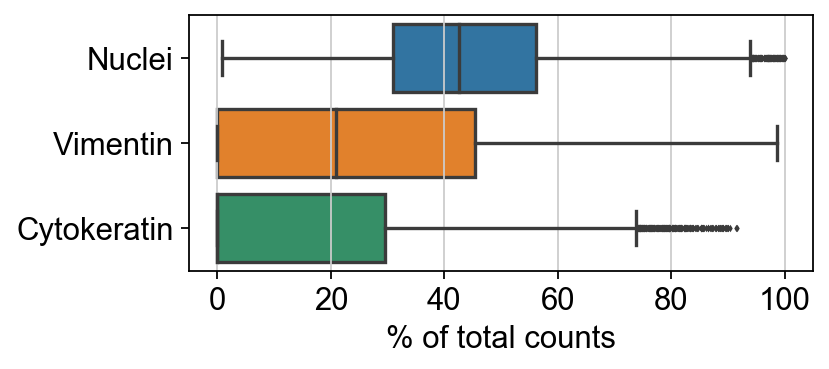

In [11]:
sc.pl.highest_expr_genes(adata, n_top=3)

#### Filter cells according to theire total brighness, area and circularity and process values for further analysis:

... storing 'Annotation' as categorical
... storing 'Gated_population_1' as categorical
... storing 'Gated_population_2' as categorical


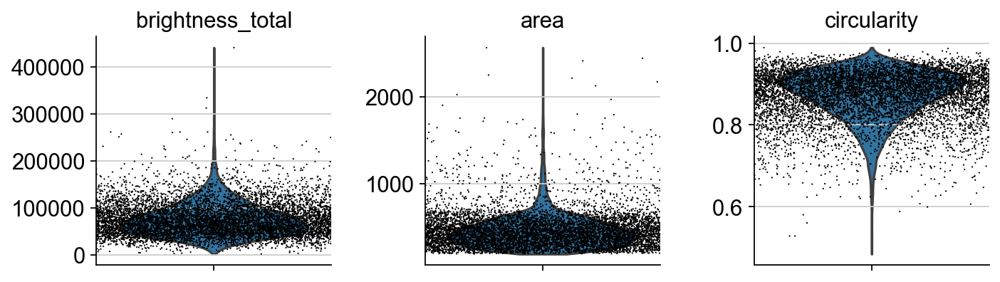

In [12]:
adata.obs['brightness_total'] = adata.X.sum(axis=1)
sc.pl.violin(adata, ['brightness_total','area','circularity'], jitter=0.8, multi_panel=True)

In [13]:
adata = adata[adata.obs['brightness_total'] < 200000, :]
adata = adata[adata.obs['area'] < 800, :]
adata = adata[adata.obs['circularity'] > 0.75, :]

In [14]:
var_data=pd.DataFrame(adata.X) #save var data for later merging with neighborhood matrix

In [15]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
sc.pp.scale(adata, max_value=10)

/Users/Sebastian/miniconda3/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:297: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(data)


## Generate distance matrix

In [16]:
calculate=False #Needs to be true to calculate the distances the first time. Set to false afterwards in order to save time

In [17]:
if calculate == True:
    distances=np.empty([len(adata.obs_names),len(adata.obs_names)])
    x_values=adata.obs.X
    y_values=adata.obs.Y
    for j in range (distances.shape[0]):
        distances[j,j:] = ((x_values[j:].apply(lambda x: (x-x_values[j])**2))+(y_values[j:].apply(lambda y: (y-y_values[j])**2)))**(.5)
        print("Progress: {:2.1%}".format(j/distances.shape[0]), end="\r")

In [18]:
# Make the matrix symetric
if calculate == True:
    arr = distances
    arr2 = np.triu(arr) + np.triu(arr,1).T
    distances_completed=pd.DataFrame(arr2)
    distances_completed.columns=adata.obs_names
    distances_completed.index=adata.obs_names
    distances_completed.to_csv('./export/distances_completed.csv')

In [19]:
distances_completed = pd.read_csv('./export/distances_completed.csv',index_col=0)

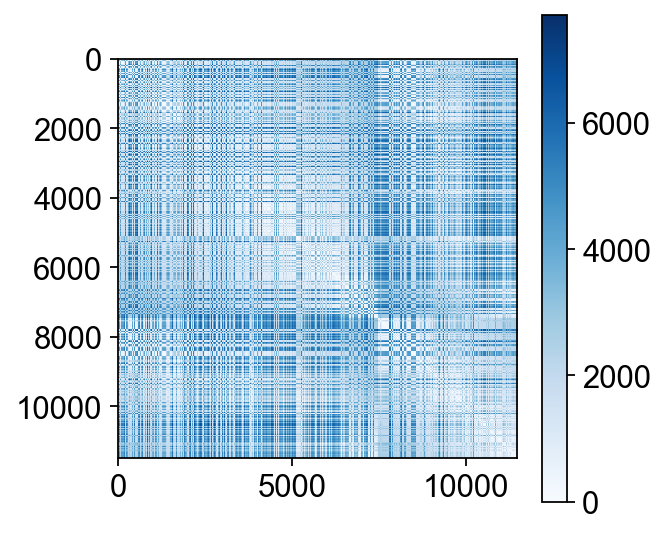

In [20]:
plt.imshow(distances_completed.astype(float), zorder=2, cmap='Blues', interpolation='nearest')
plt.colorbar()
plt.show()

# Visualisation and Dimensional reduction

#### Plot cells and check if the tissue architechture is preserved, or if too many cells have been filtered out:

/Users/Sebastian/miniconda3/lib/python3.7/site-packages/scanpy/plotting/_utils.py:734: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  ax_cb = fig.add_axes(rectangle)
/Users/Sebastian/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:9: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  if __name__ == '__main__':


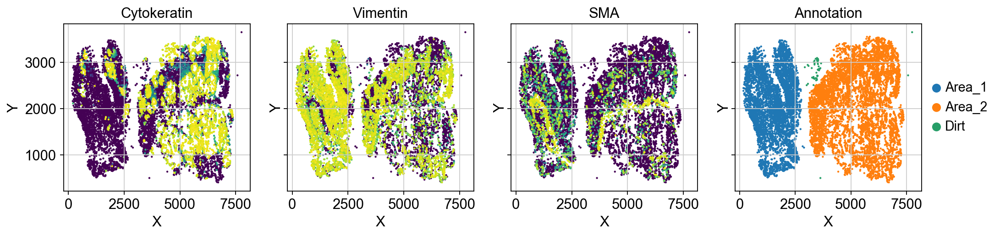

In [21]:
fig, axes = plt.subplots(ncols=4, figsize=(15, 3), sharey=True)

ax1, ax2, ax3, ax4 = axes
sc.pl.scatter(adata, 'X', 'Y', color='Cytokeratin', color_map='viridis', ax=ax1, show=False, size=15)
sc.pl.scatter(adata, 'X', 'Y', color='Vimentin', color_map='viridis', ax=ax2, show=False, size=15)
sc.pl.scatter(adata, 'X', 'Y', color='SMA', color_map='viridis', ax=ax3, show=False, size=15)
sc.pl.scatter(adata, 'X', 'Y', color='Annotation', color_map='viridis', ax=ax4, show=False, size=15)
fig.delaxes(fig.axes[4]) 
fig.show()

#### Run PCA, neighborhood embedding, UMAP and leiden clustering:

In [22]:
sc.tl.pca(adata)

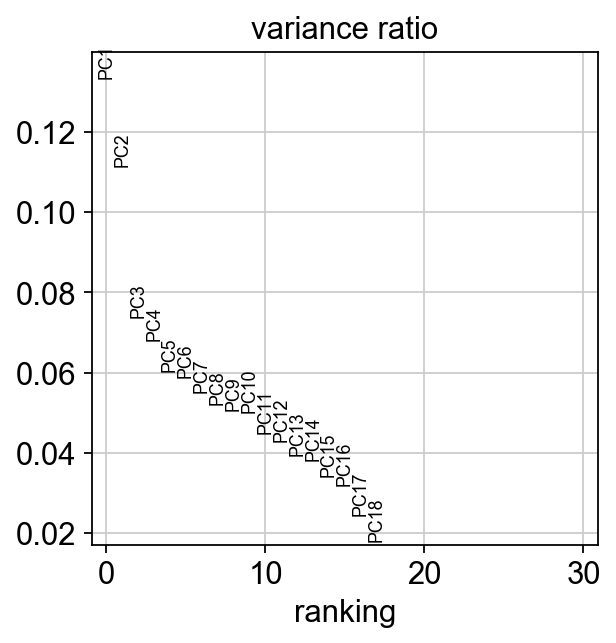

In [23]:
sc.pl.pca_variance_ratio(adata)

In [24]:
sc.pp.neighbors(adata, n_neighbors=50, n_pcs=7)
sc.tl.umap(adata, min_dist=1.7)
sc.tl.leiden(adata)
sc.pl.umap(adata, color=['Gated_population_1', 'leiden'], ncols=2, legend_loc='on data')

/Users/Sebastian/miniconda3/lib/python3.7/site-packages/numba/typed_passes.py:293: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../miniconda3/lib/python3.7/site-packages/umap/rp_tree.py", line 135:
@numba.njit(fastmath=True, nogil=True, parallel=True)
def euclidean_random_projection_split(data, indices, rng_state):
^

  state.func_ir.loc))
/Users/Sebastian/miniconda3/lib/python3.7/site-packages/umap/nndescent.py:92: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../miniconda3/lib/python3.7/site-packag

#### Analyze and plot marker genes to annotate cell populations:
(for more ways of analyzing marker genes have a look at the scanpy documentation)

/Users/Sebastian/miniconda3/lib/python3.7/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  rankings_gene_logfoldchanges.append(np.log2(foldchanges[global_indices]))


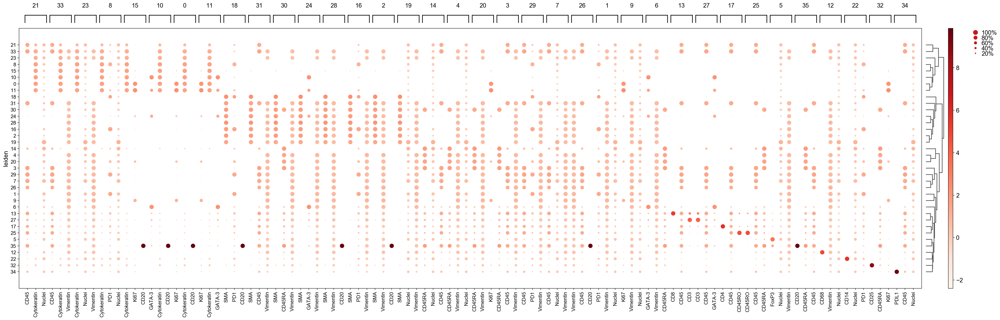

In [29]:
sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups_dotplot(adata, n_genes=3)

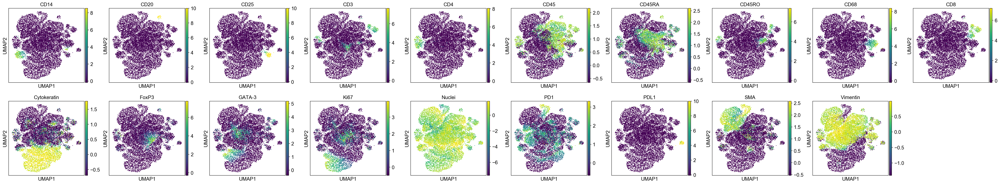

In [30]:
sc.pl.umap(adata, color=adata.var_names, ncols=10)

In [31]:
adata=adata[adata.obs.leiden!='32']

#### Annotate clusters and change colors for cell populations:

In [32]:
pd.set_option('mode.chained_assignment', None)
adata.obs['celltype_Level_1']='undefined'
adata.obs.celltype_Level_1[adata.obs.leiden.isin(['0','11','8','15','10','21'])]='Epithelial cells'
adata.obs.celltype_Level_1[adata.obs.leiden.isin(['19','2','16','18','30','31','28','24'])]='muscular cells'
adata.obs.celltype_Level_1[adata.obs.leiden.isin(['1','6','27','23','9','5'])]='Lamina propria cells'
adata.obs.celltype_Level_1[adata.obs.leiden.isin(['13','12','33','7','25','34','26','29','17','3','4','20','14','35','22','26'])]='Lymphocytes'

Trying to set attribute `.obs` of view, copying.


In [33]:
adata.obs['celltype_epithelial']='non-epithelial cells'
adata.obs.celltype_epithelial[adata.obs.leiden.isin(['21'])]='intraepithelial Lymphocytes'
adata.obs.celltype_epithelial[adata.obs.leiden.isin(['0','11'])]='Ki67 high epithelial'
adata.obs.celltype_epithelial[adata.obs.leiden.isin(['10'])]='GATA3+ epithelial'
adata.obs.celltype_epithelial[adata.obs.leiden.isin(['8'])]='Ki67 low epithelial'
adata.obs.celltype_epithelial[adata.obs.leiden.isin(['15'])]='SMA+ epithelial'

In [34]:
adata.obs['celltype_muscular']='non-muscular cells'
adata.obs.celltype_muscular[adata.obs.leiden.isin(['31'])]='intramuscular Lymphocytes'
adata.obs.celltype_muscular[adata.obs.leiden.isin(['18','19','2','16','30','28','24'])]='muscular cells'

In [35]:
adata.obs['celltype_lymphocytes']='CD45- cells'
adata.obs.celltype_lymphocytes[adata.obs.leiden.isin(['31'])]='intramuscular Lymphocytes'
adata.obs.celltype_lymphocytes[adata.obs.leiden.isin(['21'])]='intraepithelial Lymphocytes'
adata.obs.celltype_lymphocytes[adata.obs.leiden.isin(['13'])]='CD8 T cells'
adata.obs.celltype_lymphocytes[adata.obs.leiden.isin(['17'])]='CD4 T cells'
adata.obs.celltype_lymphocytes[adata.obs.leiden.isin(['22'])]='Monocytes'
adata.obs.celltype_lymphocytes[adata.obs.leiden.isin(['12'])]='Macrophages'
adata.obs.celltype_lymphocytes[adata.obs.leiden.isin(['35'])]='B cells'
adata.obs.celltype_lymphocytes[adata.obs.leiden.isin(['34'])]='PD-L1+ cells'
adata.obs.celltype_lymphocytes[adata.obs.leiden.isin(['4','14','3','25','7','26','29','33'])]='other Lymphocytes'

In [36]:
adata.obs['celltype_Level_2']='not specified'

In [37]:
adata.obs.celltype_Level_2[adata.obs.celltype_epithelial != 'non-epithelial cells']=adata.obs.celltype_epithelial
adata.obs.celltype_Level_2[adata.obs.celltype_muscular != 'non-muscular cells']=adata.obs.celltype_muscular
adata.obs.celltype_Level_2[adata.obs.celltype_lymphocytes != 'CD45- cells']=adata.obs.celltype_lymphocytes
adata.obs.celltype_Level_2[adata.obs.leiden.isin(['1','20','6','27','23','9','5'])]='Lamina propria cells'

In [38]:
adata.uns['celltype_epithelial_colors']=['#1f77b4','#ff7f0e','#279e68','#d62728','#aa40fc','#d1d1d1']
adata.uns['celltype_muscular_colors']=['#1f77b4', '#ff7f0e', '#d1d1d1']
adata.uns['celltype_Level_2_colors']=['#1f77b4','#b41f1f','#b4821f','#279e68','#c4d627','#aa40fc','#8c564b','#e377c2','#b5bd61','#0b7510','#750b73','#750b0b','#ad78d6','#9edae5','#dbdb8d']
adata.uns['celltype_lymphocytes_colors']=['#1f77b4','#b41f1f','#b4821f','#d1d1d1','#279e68','#c4d627','#aa40fc','#8c564b','#e377c2','#b5bd61','#130b75','#0b6a75']
adata.uns['Gated_population_2_colors']=['#1f77b4','#279e68','#c4d627','#d62728','#aa40fc','#d1d1d1']
adata.uns['Gated_population_1_colors']=['#1f77b4', '#ff7f0e', '#279e68', '#d62728', '#d1d1d1']

... storing 'celltype_Level_1' as categorical
... storing 'celltype_epithelial' as categorical
... storing 'celltype_muscular' as categorical
... storing 'celltype_lymphocytes' as categorical
... storing 'celltype_Level_2' as categorical


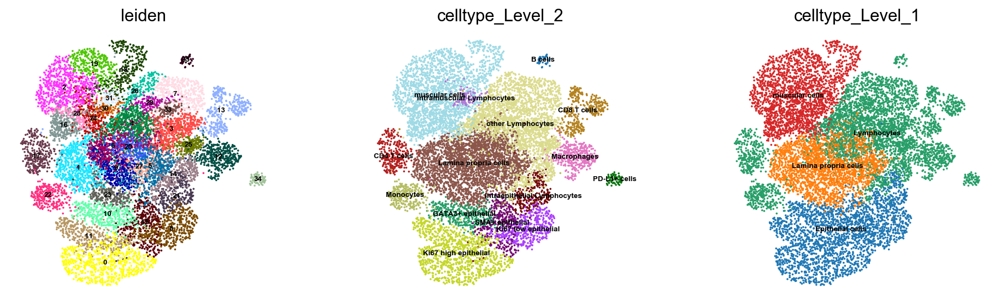

In [39]:
sc.pl.umap(adata, color=['leiden','celltype_Level_2','celltype_Level_1'], legend_loc="on data", legend_fontsize=6, frameon=False, ncols=3)

# Generate neighborhood data from distances

#### Plot the neighborhood of selected cells:

In [40]:
cells_of_interest = ['9395','2397','2609','13019'] #cells selected from different tissue regions
x=60 #set the radius (represents a 30µm range)

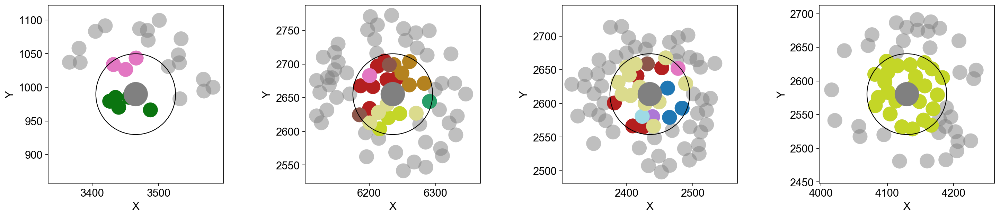

In [41]:
fig, ax = plt.subplots(ncols=4, figsize=(18, 4))
fig.tight_layout(w_pad=5)
for i, cell in enumerate(cells_of_interest):
    ax[i].set_xlim([adata.obs.loc[cell]['X']-2.2*x,adata.obs.loc[cell]['X']+2.2*x])
    ax[i].set_ylim([adata.obs.loc[cell]['Y']-2.2*x,adata.obs.loc[cell]['Y']+2.2*x])
    circle = plt.Circle((adata.obs.loc[cell]['X'], adata.obs.loc[cell]['Y']), x, edgecolor="black", facecolor='none')
    sc.pl.scatter(adata[adata.obs_names.isin(distances_completed.loc[distances_completed[cell]<=(2*x),cell].index.values.astype(str))], 'X', 'Y', size=1500, alpha=0.5, ax=ax[i], show=False)
    sc.pl.scatter(adata[adata.obs_names.isin(distances_completed.loc[distances_completed[cell]<=x,cell].index.values.astype(str))], 'X', 'Y', color='celltype_Level_2', size=1500, ax=ax[i], show=False)
    sc.pl.scatter(adata[adata.obs_names.isin([cell])], 'X', 'Y', size=4000, ax=ax[i], show=False)
    ax[i].add_artist(circle)
    ax[i].grid(False)
    ax[i].get_legend().remove()
#fig.savefig('./figures/cellsofinterest.svg')

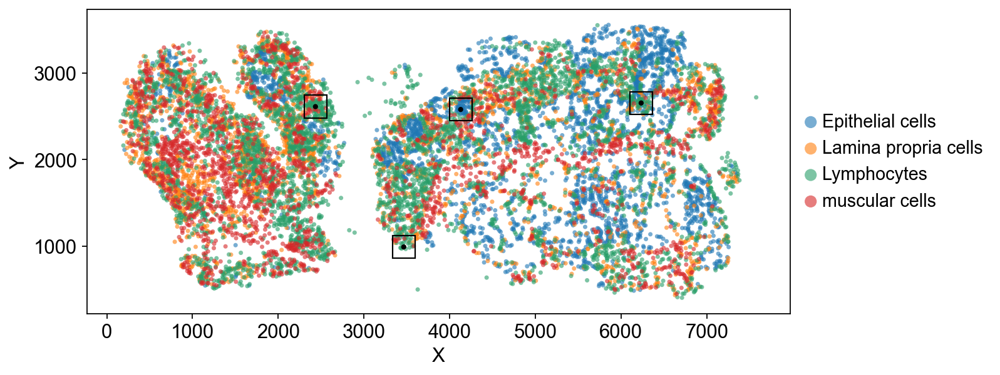

In [42]:
fig, ax = plt.subplots(figsize=(9, 4))
sc.pl.scatter(adata, 'X', 'Y', color='celltype_Level_1', title='', alpha=0.6, size=40, ax=ax, show=False)
for cell in cells_of_interest:
    rectangle=plt.Rectangle((adata.obs.loc[cell]['X']-2.2*x, adata.obs.loc[cell]['Y']-2.2*x), x*4.4, x*4.4, edgecolor='black', facecolor='none')
    circle = plt.Circle((adata.obs.loc[cell]['X'], adata.obs.loc[cell]['Y']), 30, edgecolor="none", facecolor='black')
    ax.add_artist(circle)
    ax.add_artist(rectangle)
ax.grid(False)

#### Generate the environment matrix:

In [43]:
distances_completed_na=distances_completed.replace(0,np.nan) #cells shouldnt be counted as their own neighbors
distances_completed_na[distances_completed_na>=x]=np.nan #exclude distances greater than the selected radius x

In [44]:
neighbours=pd.DataFrame()
for i in range(adata.obs.celltype_Level_2.nunique()):
    neighbours[i]=distances_completed_na.loc[:,adata.obs_names[adata.obs.celltype_Level_2==np.sort(adata.obs.celltype_Level_2.unique()).astype(str)[i]].values].count(axis=1)

In [45]:
for i, cluster in enumerate(adata.obs.celltype_Level_2.unique()):
    neighbours.iloc[:,i]=neighbours.iloc[:,i]/(adata[adata.obs.celltype_Level_2==cluster].shape[0]/adata.shape[0])

In [46]:
neighbours.columns=np.sort(adata.obs.celltype_Level_2.unique()).astype(str)

In [47]:
#for cell in neighbours.index.astype(str).tolist():
#    phenotype=adata.obs.loc[cell].celltype_Level_2
#    neighbours.loc[int(cell),neighbours.columns==phenotype]=0

In [48]:
#Process and merge the adata.var matrix with the distance matrix
var_data.columns=adata.var_names
var_data.index=neighbours.index
neighbours.columns=np.sort(adata.obs.celltype_Level_2.unique()).astype(str)
var_data_merged=pd.concat([neighbours, var_data], axis=1)
var_data_merged=var_data_merged[var_data_merged.index.isin(adata.obs_names)]
var_data_merged.to_csv('./export/var_data_merged.csv', index=False)
adata_neigbours=sc.read_csv('./export/var_data_merged.csv')
sc.pp.normalize_total(adata_neigbours, target_sum=1e4)
sc.pp.log1p(adata_neigbours)
sc.pp.scale(adata_neigbours, max_value=10)
adata_neigbours.obs=adata.obs
adata_neigbours.uns=adata.uns
adata_neigbours.var['feature_types']='gene_expression'
adata_neigbours.var['feature_types'][:adata_neigbours.obs.celltype_Level_2.nunique()]='distance'

# Cluster neighborhood matrix

In [49]:
adata_neigbours_only=adata_neigbours[:,adata_neigbours.var.feature_types=='distance']
adata_neigbours_only.obs['n_counts'] = adata_neigbours_only.X.sum(axis=1)

Trying to set attribute `.obs` of view, copying.


/Users/Sebastian/miniconda3/lib/python3.7/site-packages/numba/typed_passes.py:293: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../miniconda3/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  state.func_ir.loc))
... storing 'feature_types' as categorical


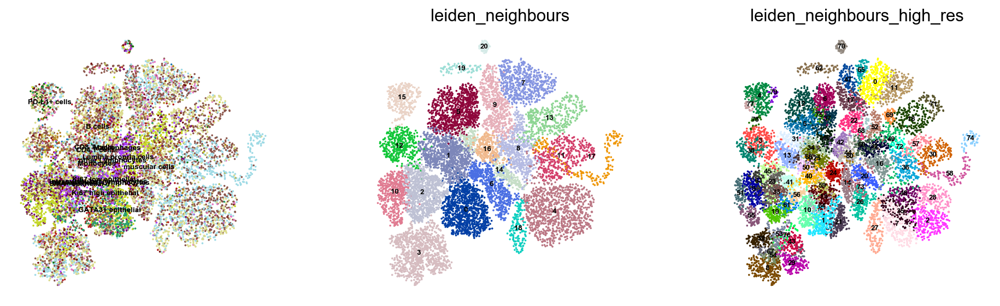

In [50]:
sc.tl.pca(adata_neigbours_only, svd_solver='arpack')
sc.pp.neighbors(adata_neigbours_only, n_neighbors=50, n_pcs=5)
sc.tl.umap(adata_neigbours_only, min_dist=1.9)
sc.tl.leiden(adata_neigbours_only, key_added='leiden_neighbours', resolution=0.5)
sc.tl.leiden(adata_neigbours_only, key_added='leiden_neighbours_high_res', resolution=6)
sc.pl.umap(adata_neigbours_only, color=['celltype_Level_2','leiden_neighbours','leiden_neighbours_high_res'], legend_loc='on data', title='', legend_fontsize=6, frameon=False)

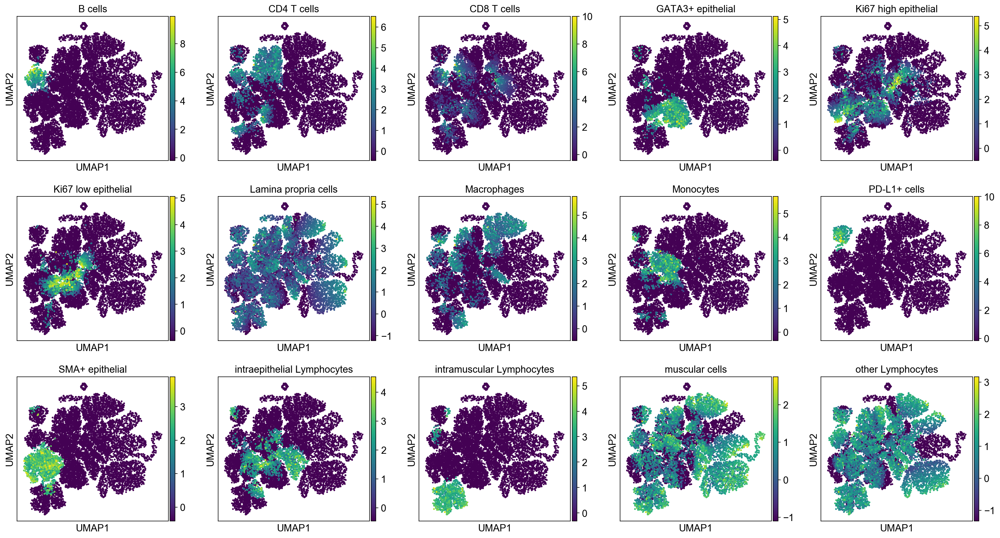

In [237]:
sc.pl.umap(adata_neigbours_only, color=adata_neigbours_only.var_names, ncols=5, size=25, save='names.pdf')

#### Plot random examples from selected neighborhood clusters:

In [52]:
def plot_neighbours(cell, ax, show_same=True):
    x=60
    ax.set_xlim([adata.obs.loc[cell]['X']-1.2*x,adata.obs.loc[cell]['X']+1.2*x])
    ax.set_ylim([adata.obs.loc[cell]['Y']-1.2*x,adata.obs.loc[cell]['Y']+1.2*x])
    plotdata=adata[adata.obs_names.isin(distances_completed_na.loc[distances_completed_na[cell]<=x,cell].index.values.astype(str))]
    
    if show_same==True:
        sc.pl.scatter(plotdata, 'X', 'Y', color='celltype_Level_2', size=400, ax=ax, show=False)
    else:
        sc.pl.scatter(plotdata[plotdata.obs.celltype_Level_2.values.astype(str)!=adata.obs[adata.obs_names==cell].celltype_Level_2.values.astype(str)], 'X', 'Y', color='celltype_Level_2', size=400, ax=ax, show=False)
        sc.pl.scatter(plotdata[plotdata.obs.celltype_Level_2.values.astype(str)==adata.obs[adata.obs_names==cell].celltype_Level_2.values.astype(str)], 'X', 'Y', color='celltype_Level_2', size=400, ax=ax, alpha=0.2, show=False)
    
    sc.pl.scatter(adata[adata.obs_names.isin([cell])], 'X', 'Y', size=800, color='celltype_Level_2', ax=ax, show=False)
    circle = plt.Circle((adata.obs.loc[cell]['X'], adata.obs.loc[cell]['Y']), 10, edgecolor="black", facecolor='none')
    ax.add_artist(circle)
    ax.grid(False)
    ax.get_legend().remove()
    ax.set_xticklabels([])
    ax.set_xticks([])
    ax.set_yticklabels([])
    ax.set_yticks([])
    ax.set_ylabel('')
    ax.set_xlabel('')
    ax.set_title('')

In [78]:
def plot_neighbours_2(cell, ax, defining_phenotype, show_only_defining=True):
    x=60
    ax.set_xlim([adata.obs.loc[cell]['X']-1.2*x,adata.obs.loc[cell]['X']+1.2*x])
    ax.set_ylim([adata.obs.loc[cell]['Y']-1.2*x,adata.obs.loc[cell]['Y']+1.2*x])
    plotdata=adata[adata.obs_names.isin(distances_completed_na.loc[distances_completed_na[cell]<=x,cell].index.values.astype(str))]
    
    if show_only_defining==True:
        sc.pl.scatter(plotdata[plotdata.obs.celltype_Level_2.values.astype(str)==defining_phenotype], 'X', 'Y', color='celltype_Level_2', size=400, ax=ax, show=False)
        sc.pl.scatter(plotdata[plotdata.obs.celltype_Level_2.values.astype(str)!=defining_phenotype], 'X', 'Y', color='celltype_Level_2', size=400, ax=ax, alpha=0.3, show=False)
    else:
        sc.pl.scatter(plotdata, 'X', 'Y', color='celltype_Level_2', size=400, ax=ax, show=False)
    
    sc.pl.scatter(adata[adata.obs_names.isin([cell])], 'X', 'Y', size=800, color='celltype_Level_2', ax=ax, show=False)
    circle = plt.Circle((adata.obs.loc[cell]['X'], adata.obs.loc[cell]['Y']), 10, edgecolor="black", facecolor='none')
    ax.add_artist(circle)
    ax.grid(False)
    ax.get_legend().remove()
    ax.set_xticklabels([])
    ax.set_xticks([])
    ax.set_yticklabels([])
    ax.set_yticks([])
    ax.set_ylabel('')
    ax.set_xlabel('')
    ax.set_title('')

Environment cluster 8


No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


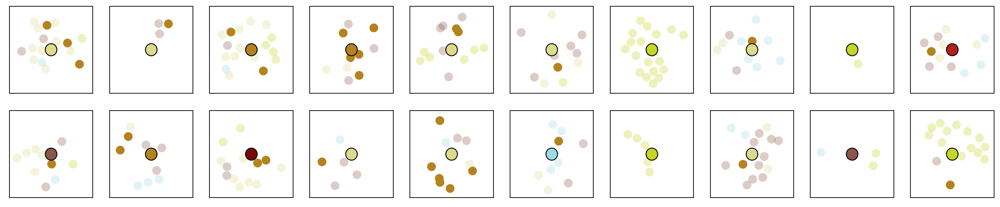

Environment cluster 10


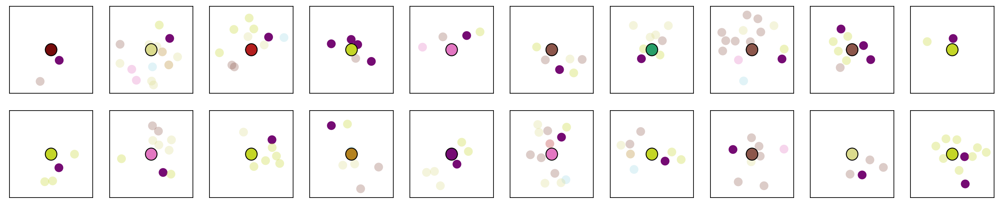

Environment cluster 12


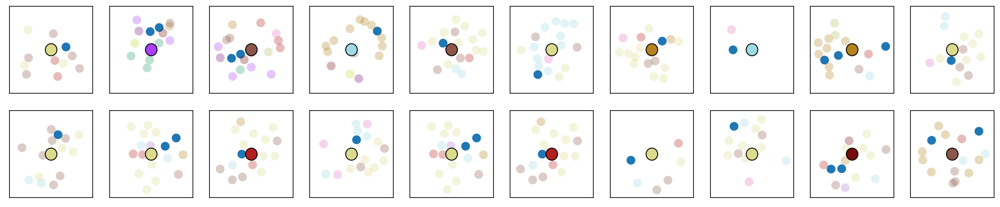

Environment cluster 16


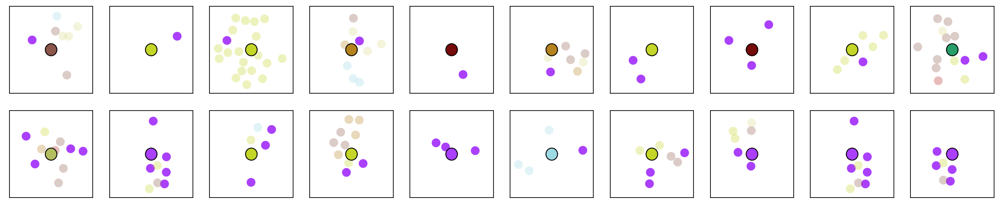

Environment cluster 17


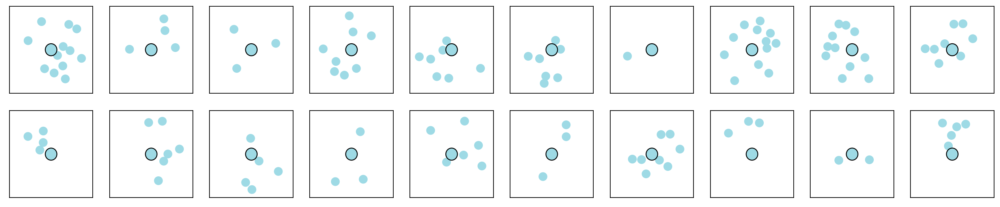

In [200]:
for j in [8,10,12,16,17]:
    print('Environment cluster '+str(j))
    fig, ax = plt.subplots(ncols=10,nrows=2, figsize=(20,4))
    i=0
    defining_phenotype=pd.DataFrame(adata_neigbours_only[adata_neigbours_only.obs.leiden_neighbours==str(j)].X, columns=adata_neigbours_only.var_names).mean().sort_values(ascending=False).index[0]
    for cell in np.random.choice(adata_neigbours_only[adata_neigbours_only.obs.leiden_neighbours==str(j)].obs_names.values, size=20):
        plot_neighbours_2(cell, ax.reshape(-1)[i], defining_phenotype)
        i=i+1
    plt.show()
    fig.savefig('./figures/cluster_'+str(j)+'.svg')

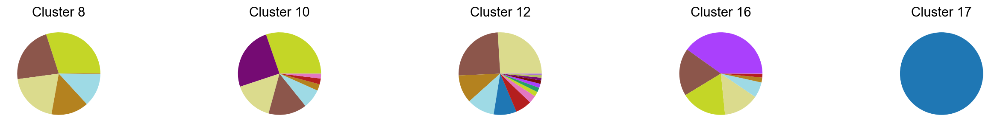

In [206]:
fig, ax = plt.subplots(ncols=5, figsize=(20,2))
for i,j in enumerate([8,10,12,16,17]):
    df=pd.DataFrame()
    for cell in adata_neigbours_only[adata_neigbours_only.obs.leiden_neighbours==str(j)].obs_names.values:
        data=pd.DataFrame(adata.obs[adata.obs_names.isin(distances_completed_na.loc[distances_completed_na[cell]<=(2*x),cell].index.values.astype(str))]["celltype_Level_2"].value_counts())
        data=data/data[data['celltype_Level_2']>0].sum()
        df=pd.concat([df,data], axis=1)
    
    data_all=pd.DataFrame(df.mean(axis=1), columns=['value'])
    data_all['color']=adata.uns['celltype_Level_2_colors']
    data_all=data_all.sort_values('value', ascending=False)
    ax[i].pie(data_all.value, colors=data_all.color)
    ax[i].set_title('Cluster '+str(j))

fig.savefig('./figures/pie_clusters.svg')
plt.show()

In [55]:
from matplotlib.colors import LinearSegmentedColormap
# get colormap
ncolors = 256
color_array = plt.get_cmap('viridis')(range(ncolors))
# change alpha values
color_array[:,-1] = np.linspace(0.0,1.0,ncolors)
# create a colormap object
map_object = LinearSegmentedColormap.from_list(name='Viridis_alpha',colors=color_array)
# register this new colormap with matplotlib
plt.register_cmap(cmap=map_object)

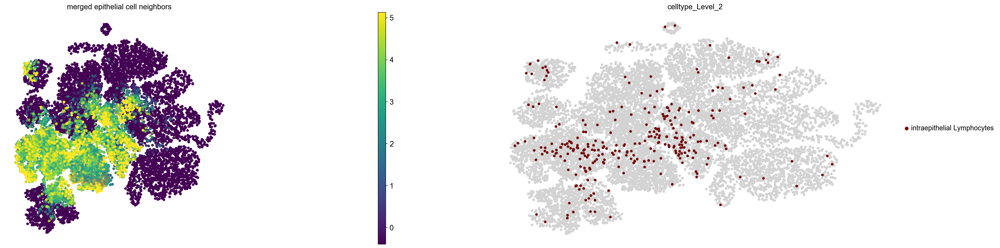

In [56]:
fig, ax=plt.subplots(ncols=2, figsize=(30,8))
sc.pl.umap(adata_neigbours_only, color='GATA3+ epithelial', frameon=False, ax=ax[0], size=100, show=False, color_map='viridis')
for color in adata_neigbours_only.var_names[adata_neigbours_only.var_names.str.contains('epithelial')]:
    sc.pl.umap(adata_neigbours_only, color=color, frameon=False, ax=ax[0], show=False, size=100, vmax=3, color_map='Viridis_alpha')
    fig.delaxes(fig.axes[3]) 
sc.pl.umap(adata_neigbours_only, color=['celltype_Level_2'], groups='intraepithelial Lymphocytes', ax=ax[1], size=100, show=False, frameon=False)
ax[0].set_title('merged epithelial cell neighbors')
plt.show()

In [57]:
exp=[adata[adata.obs.celltype_Level_2==cluster].shape[0] for cluster in adata.obs.celltype_Level_2.unique()]

In [58]:
statistics=[]
pval=[]
for cluster in adata_neigbours_only.obs.leiden_neighbours.unique():
    factor=adata_neigbours_only[adata_neigbours_only.obs.leiden_neighbours==cluster].shape[0]/adata.shape[0]
    exp=[i*factor for i in exp]
    obs=adata_neigbours_only.obs.celltype_Level_2[adata_neigbours_only.obs.leiden_neighbours==cluster].value_counts(sort=False).tolist()
    stat,p = stats.chisquare(obs,exp)
    statistics.append(stat)
    pval.append(p)
    
results_chi=pd.DataFrame(data=[statistics,pval], index=['statistic','pvalue'], columns=adata_neigbours_only.obs.leiden_neighbours.unique())

In [59]:
results_chi=results_chi.T

In [101]:
df_all=pd.DataFrame()
for i, j in enumerate(adata_neigbours_only.obs.leiden_neighbours.unique()):
    df=pd.DataFrame()
    for cell in adata_neigbours_only[adata_neigbours_only.obs.leiden_neighbours==str(j)].obs_names.values:
        data=pd.DataFrame(adata.obs[adata.obs_names.isin(distances_completed_na.loc[distances_completed_na[cell]<=(2*x),cell].index.values.astype(str))]["celltype_Level_2"].value_counts())
        data=data/data[data['celltype_Level_2']>0].sum()
        df=pd.concat([df,data], axis=1)
    df_all=pd.concat([df_all,pd.DataFrame(df.mean(axis=1),columns=[str(j)])], axis=1)
df_all=df_all.T

In [102]:
for i, cluster in enumerate(adata.obs.celltype_Level_2.unique()):
    df_all.iloc[:,i]=df_all.iloc[:,i]/(adata[adata.obs.celltype_Level_2==cluster].shape[0]/adata.shape[0])

In [103]:
simpson_list=[]
for i in range(df_all.shape[0]):
    simpson_list.append(sum(n**2 for n in df_all.iloc[i]))
    
df_all.columns=df_all.columns.astype(str)
df_all['Diversity']=simpson_list
df_all=df_all.sort_values('Diversity', ascending=False)

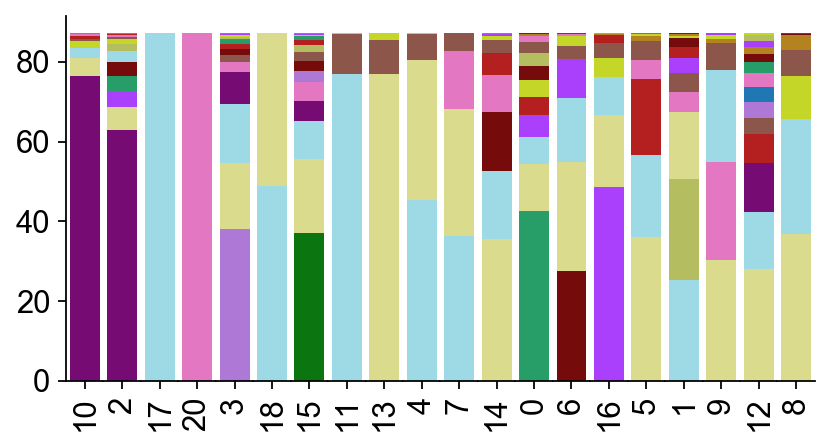

In [104]:
fig, ax = plt.subplots(ncols=20, figsize=(6,3))
for i in range (20):
    data=pd.concat([pd.DataFrame(df_all.iloc[i,:-1]),
               pd.DataFrame(adata_neigbours_only.uns['celltype_Level_2_colors'].tolist(),
                            index=df_all.columns[:-1], 
                            columns=['color'])], axis=1).sort_values(df_all.index[i], ascending=False).T
    pd.DataFrame(data.iloc[0]).T.plot(kind='bar', stacked=True, legend=None, grid=False, color=data.iloc[1], ax=ax[i], width=2)
    ax[i].axes.get_yaxis().set_visible(False)
    ax[i].spines['top'].set_visible(False)
    ax[i].spines['right'].set_visible(False)
    ax[i].spines['left'].set_visible(False)
ax[0].axes.get_yaxis().set_visible(True)
ax[0].spines['left'].set_visible(True)
plt.subplots_adjust(wspace=0, hspace=0)

In [105]:
df_all

,B cells,CD4 T cells,CD8 T cells,GATA3+ epithelial,Ki67 high epithelial,Ki67 low epithelial,Lamina propria cells,Macrophages,Monocytes,PD-L1+ cells,SMA+ epithelial,intraepithelial Lymphocytes,intramuscular Lymphocytes,muscular cells,other Lymphocytes,Diversity
10,0.000000,0.656772,0.105557,0.005251,1.680272,0.003876,0.666034,0.591823,0.003828,0.000000,76.391321,0.000000,0.000000,2.609193,4.448273,5866.288665
2,0.000000,0.282186,0.074418,2.875971,0.965657,3.265710,0.517358,0.284364,1.291803,0.000000,48.613787,2.630921,0.037725,2.151362,4.475373,2416.851784
17,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,34.445455,0.000000,1186.489339
20,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,31.314050,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,980.569702
3,0.000000,0.669170,0.116913,0.588473,0.194076,0.149364,0.875603,1.219218,0.240621,0.000000,4.056864,0.804895,19.061667,7.409570,8.232316,506.304688
18,0.000000,0.000000,0.000000,0.000000,0.015921,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,17.583140,13.829931,500.434080
15,0.080874,0.480735,0.049859,0.440559,0.097314,0.088039,1.030503,2.095777,0.765761,16.099194,2.174242,1.077618,1.173303,4.150727,8.072396,355.333431
11,0.000000,0.000000,0.000000,0.000000,0.056789,0.000000,2.216985,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,16.961941,0.000000,292.625680
13,0.000000,0.000000,0.000000,0.000000,0.346855,0.000000,1.738827,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,15.557443,245.177873
4,0.000000,0.000000,0.000000,0.000000,0.060031,0.000000,1.588487,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,11.219875,8.727288,204.578049


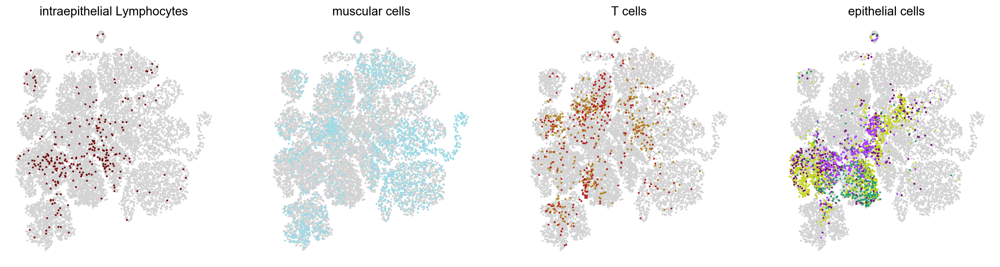

In [219]:
fig, ax = plt.subplots(ncols=4, figsize=(20,5))
sc.pl.umap(adata_neigbours_only, color=['celltype_Level_2'], title='intraepithelial Lymphocytes', legend_loc=None, groups='intraepithelial Lymphocytes', size=20, frameon=False, ax=ax[0], show=False)
sc.pl.umap(adata_neigbours_only, color=['celltype_Level_2'], title='muscular cells', groups='muscular cells', size=20, frameon=False, legend_loc=None, ax=ax[1], show=False)
sc.pl.umap(adata_neigbours_only, color=['celltype_Level_2'], title='T cells', groups=['CD4 T cells','CD8 T cells'], size=20, legend_loc=None, frameon=False, ax=ax[2], show=False)
sc.pl.umap(adata_neigbours_only, color=['celltype_Level_2'], title='epithelial cells', groups=['Ki67 high epithelial','Ki67 low epithelial','SMA+ epithelial','GATA3+ epithelial'], legend_loc=None, size=20, frameon=False, ax=ax[3], show=False)
plt.show()

In [132]:
df_members=pd.DataFrame()
for i, j in enumerate(df_all[:20].index.values.tolist()):
    data=adata.obs[adata.obs_names.isin(adata_neigbours_only[adata_neigbours_only.obs.leiden_neighbours==str(j)].obs_names.values)].celltype_Level_2.value_counts(normalize=True)
    df_members=pd.concat([df_members,data], axis=1)   
df_members.columns=df_all[:20].index.values.tolist()
df_members=df_members.T

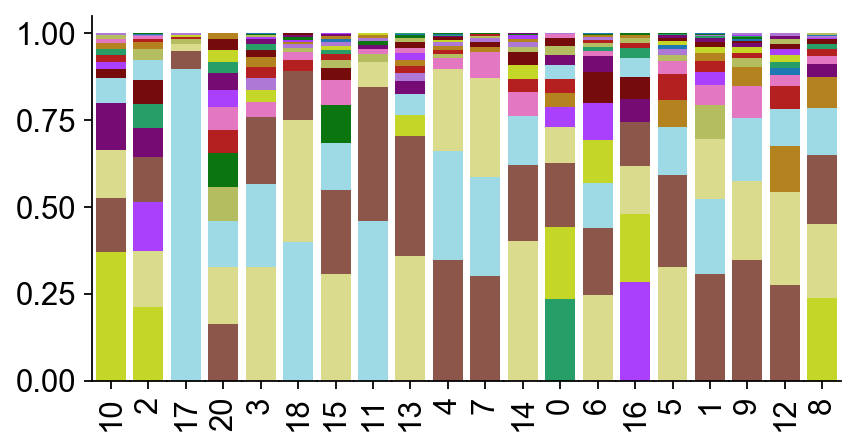

In [65]:
fig, ax = plt.subplots(ncols=20, figsize=(6,3))
for i in range (20):
    data=pd.concat([pd.DataFrame(df_members.iloc[i,:]),
               pd.DataFrame(adata_neigbours_only.uns['celltype_Level_2_colors'].tolist(),
                            index=df_all.columns[:-1], 
                            columns=['color'])], axis=1, sort=True).sort_values(df_all.index[i], ascending=False).T
    pd.DataFrame(data.iloc[0]).T.plot(kind='bar', stacked=True, legend=None, grid=False, color=data.iloc[1], ax=ax[i], width=2)
    ax[i].axes.get_yaxis().set_visible(False)
    ax[i].spines['top'].set_visible(False)
    ax[i].spines['right'].set_visible(False)
    ax[i].spines['left'].set_visible(False)
ax[0].axes.get_yaxis().set_visible(True)
ax[0].spines['left'].set_visible(True)
plt.subplots_adjust(wspace=0, hspace=0)

In [168]:
df_members['epithelial']=df_members['Ki67 low epithelial']+df_members['Ki67 high epithelial']+df_members['SMA+ epithelial']+df_members['GATA3+ epithelial']

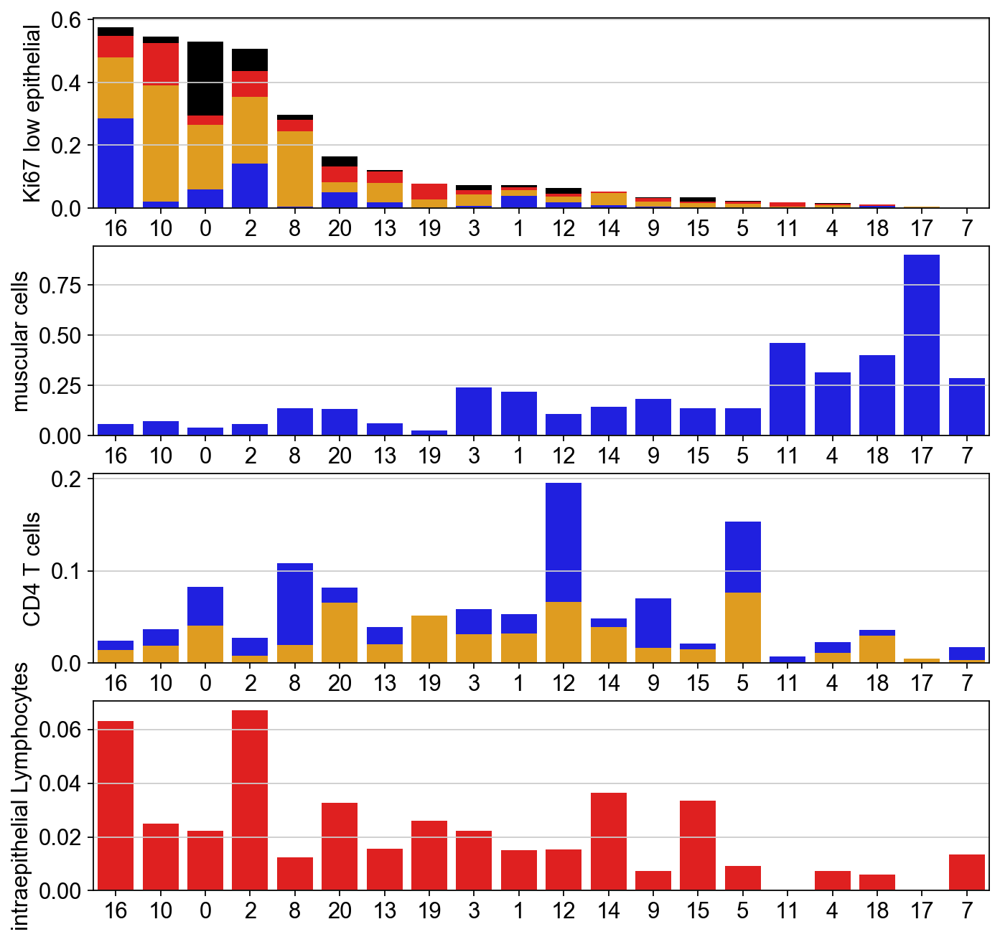

In [181]:
fig, ax = plt.subplots(nrows=4, figsize=(10,10))
sns.barplot(x=df_members.index, y=df_members['epithelial'], color='black', ax=ax[0], order=df_members.sort_values('epithelial', ascending=False).index)
sns.barplot(x=df_members.index, y=(df_members['Ki67 low epithelial']+df_members['Ki67 high epithelial']+df_members['SMA+ epithelial']), color='red', ax=ax[0], order=df_members.sort_values('epithelial', ascending=False).index)
sns.barplot(x=df_members.index, y=(df_members['Ki67 low epithelial']+df_members['Ki67 high epithelial']), color='orange', ax=ax[0], order=df_members.sort_values('epithelial', ascending=False).index)
sns.barplot(x=df_members.index, y=df_members['Ki67 low epithelial'], color='blue', ax=ax[0], order=df_members.sort_values('epithelial', ascending=False).index)
sns.barplot(x=df_members.index, y=df_members['muscular cells'], color='blue', ax=ax[1], order=df_members.sort_values('epithelial', ascending=False).index)
sns.barplot(x=df_members.index, y=(df_members['CD4 T cells']+df_members['CD8 T cells']), color='blue', ax=ax[2], order=df_members.sort_values('epithelial', ascending=False).index)
sns.barplot(x=df_members.index, y=df_members['CD4 T cells'], color='orange', ax=ax[2], order=df_members.sort_values('epithelial', ascending=False).index)
sns.barplot(x=df_members.index, y=df_members['intraepithelial Lymphocytes'], color='red', ax=ax[3], order=df_members.sort_values('epithelial', ascending=False).index)
fig.savefig('./figures/barplots.svg')

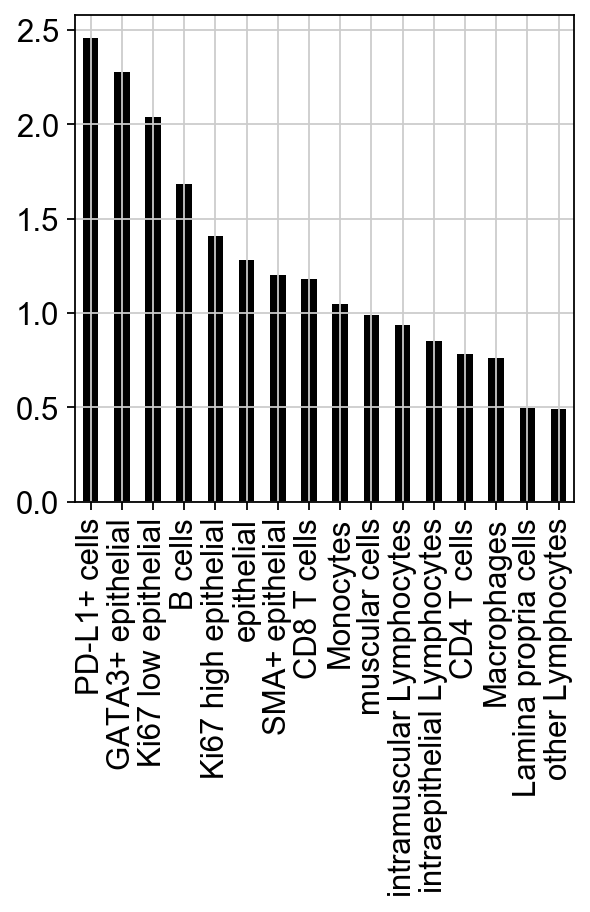

In [262]:
pd.DataFrame(df_members.std()/df_members.mean()).sort_values(0,ascending=False).plot(kind='bar', color='black', legend=None)

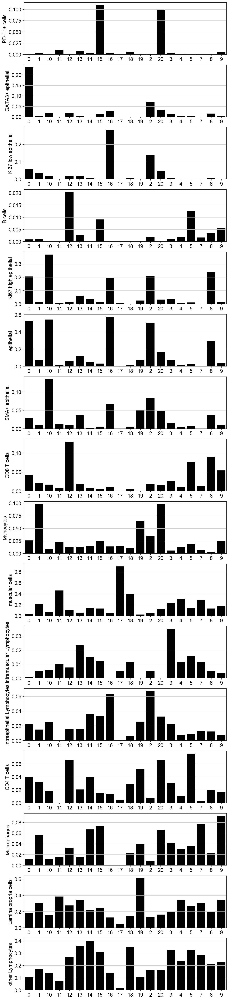

In [263]:
fig, ax = plt.subplots(nrows=16, figsize=(10,50))
for i, pop in enumerate(pd.DataFrame(df_members.std()/df_members.mean()).sort_values(0,ascending=False).index):
    sns.barplot(x=df_members.index, y=df_members[pop], color='black', ax=ax[i])

In [247]:
pd.DataFrame(df_members.std()/df_members.mean())

,0
B cells,1.685214
CD4 T cells,0.784691
CD8 T cells,1.181254
GATA3+ epithelial,2.275065
Ki67 high epithelial,1.408411
Ki67 low epithelial,2.039801
Lamina propria cells,0.496636
Macrophages,0.760523
Monocytes,1.045956
PD-L1+ cells,2.455106


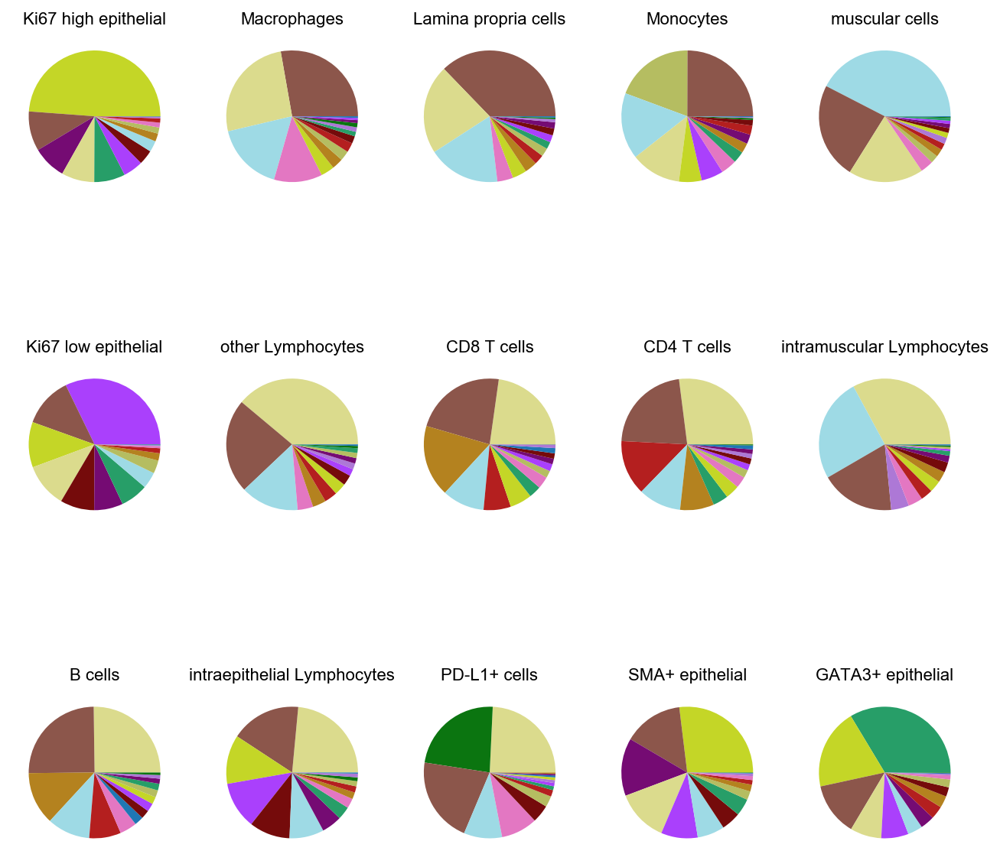

In [66]:
fig, ax = plt.subplots(ncols=5, nrows=3, figsize=(10,10))
for i,pop in enumerate(adata_neigbours_only.obs.celltype_Level_2.unique()):
    df=pd.DataFrame()
    for cell in adata_neigbours_only[adata_neigbours_only.obs.celltype_Level_2==str(pop)].obs_names.values:
        data=pd.DataFrame(adata.obs[adata.obs_names.isin(distances_completed_na.loc[distances_completed_na[cell]<=(2*x),cell].index.values.astype(str))]["celltype_Level_2"].value_counts())
        data=data/data[data['celltype_Level_2']>0].sum()
        df=pd.concat([df,data],axis=1)
        
    plotdata=pd.DataFrame(df.mean(axis=1), columns=['value'])
    plotdata['color']=adata_neigbours_only.uns['celltype_Level_2_colors']
    plotdata=plotdata.sort_values('value', ascending=False)
    ax.reshape(-1)[i].pie(plotdata.value, colors=plotdata.color)
    ax.reshape(-1)[i].set_title(str(pop), size=10)
    
plt.show()

## Subgroup to CD3 positive cells

In [220]:
adata_neighbour_CD3=adata_neigbours[adata_neigbours.obs.celltype_lymphocytes.isin(['CD4 T cells', 'CD8 T cells'])]
adata_neighbour_CD3=adata_neighbour_CD3[adata_neighbour_CD3[: , 'CD3'].X.toarray()[:,0] >=0.5, :] 

#### Investigate the neighoborhood of T cells:

In [221]:
adata_neighbour_CD3_noprot=adata_neighbour_CD3[:,adata_neighbour_CD3.var.feature_types=='distance']

... storing 'feature_types' as categorical


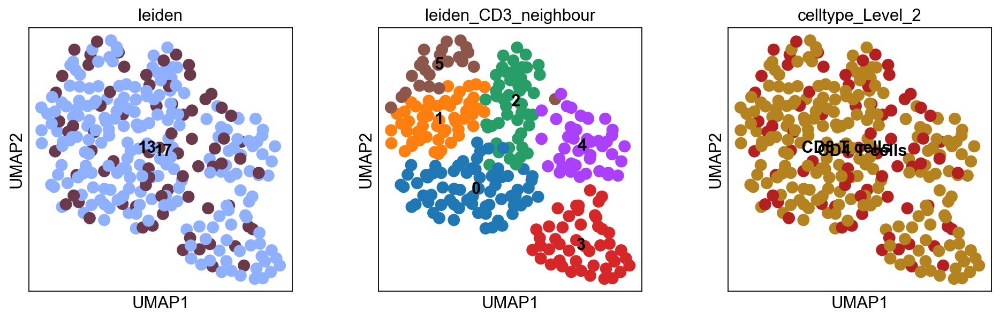

In [222]:
sc.tl.pca(adata_neighbour_CD3_noprot, svd_solver='arpack')
sc.pp.neighbors(adata_neighbour_CD3_noprot, n_neighbors=50, n_pcs=10)
sc.tl.umap(adata_neighbour_CD3_noprot, min_dist=0.8)
sc.tl.leiden(adata_neighbour_CD3_noprot, key_added='leiden_CD3_neighbour', resolution=1)
sc.pl.umap(adata_neighbour_CD3_noprot, color=['leiden','leiden_CD3_neighbour','celltype_Level_2'], legend_loc='on data', save='_CD3.svg')

/Users/Sebastian/miniconda3/lib/python3.7/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  rankings_gene_logfoldchanges.append(np.log2(foldchanges[global_indices]))


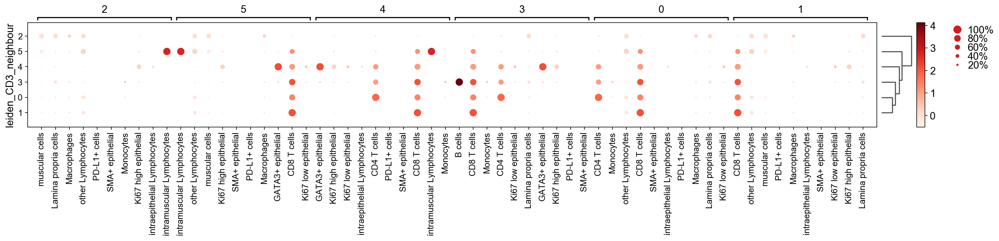

In [223]:
sc.tl.rank_genes_groups(adata_neighbour_CD3_noprot, 'leiden_CD3_neighbour', method='wilcoxon')
sc.pl.rank_genes_groups_dotplot(adata_neighbour_CD3_noprot, n_genes=10)

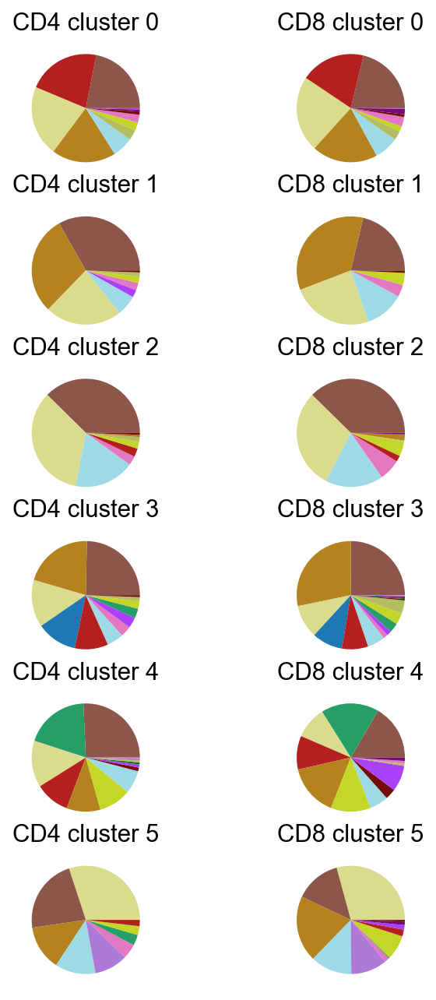

In [233]:
fig,ax=plt.subplots(ncols=2,nrows=6, figsize=(5,10))
for j in range(adata_neighbour_CD3_noprot.obs.leiden_CD3_neighbour.unique().shape[0]):
    df_CD4=pd.DataFrame()
    df_CD8=pd.DataFrame()
    for cell in adata_neighbour_CD3_noprot[adata_neighbour_CD3_noprot.obs.leiden_CD3_neighbour==str(j)].obs_names.values:
        if adata.obs.loc[cell]['celltype_Level_2']=='CD4 T cells':
            data=pd.DataFrame(adata.obs[adata.obs_names.isin(distances_completed_na.loc[distances_completed_na[cell]<=(2*x),cell].index.values.astype(str))]["celltype_Level_2"].value_counts())
            data=data/data[data['celltype_Level_2']>0].sum()
            df_CD4=pd.concat([df_CD4,data], axis=1)
            
        if adata.obs.loc[cell]['celltype_Level_2']=='CD8 T cells':
            data=pd.DataFrame(adata.obs[adata.obs_names.isin(distances_completed_na.loc[distances_completed_na[cell]<=(2*x),cell].index.values.astype(str))]["celltype_Level_2"].value_counts())
            data=data/data[data['celltype_Level_2']>0].sum()
            df_CD8=pd.concat([df_CD8,data], axis=1)
            
    #sns.barplot(data=df_CD4.T, palette=adata_neigbours_only.uns['celltype_Level_2_colors'], errwidth=0.5,errcolor='black',capsize=0.5, ax=ax[0])
    #ax[0].set_xticklabels(df.index,rotation=90,size=10)
    
    data_CD4=pd.DataFrame(df_CD4.mean(axis=1), columns=['value'])
    data_CD4['color']=adata_neigbours_only.uns['celltype_Level_2_colors']
    data_CD4=data_CD4.sort_values('value', ascending=False)
    ax.reshape(-1)[2*j].pie(data_CD4.value, colors=data_CD4.color)
    ax.reshape(-1)[2*j].set_title('CD4 cluster '+str(j))
    
    #sns.barplot(data=df_CD8.T, palette=adata_neigbours_only.uns['celltype_Level_2_colors'], errwidth=0.5,errcolor='black',capsize=0.5, ax=ax[2])
    #ax[2].set_xticklabels(df.index,rotation=90,size=10)
    
    data=pd.DataFrame(df_CD8.mean(axis=1), columns=['value'])
    data['color']=adata_neigbours_only.uns['celltype_Level_2_colors']
    data['values_CD4']=data_CD4['value']
    data=data.sort_values('values_CD4', ascending=False)
    ax.reshape(-1)[2*j+1].pie(data.value, colors=data.color)
    ax.reshape(-1)[2*j+1].set_title('CD8 cluster '+str(j))

plt.show()
fig.savefig('./figures/piechart_CD3.svg')

In [279]:
df_all_CD3=pd.DataFrame()
for i, j in enumerate(adata_neighbour_CD3_noprot.obs.leiden_CD3_neighbour.unique()):
    df=pd.DataFrame()
    for cell in adata_neighbour_CD3_noprot[adata_neighbour_CD3_noprot.obs.leiden_CD3_neighbour==str(j)].obs_names.values:
        data=pd.DataFrame(adata.obs[adata.obs_names.isin(distances_completed_na.loc[distances_completed_na[cell]<=(2*x),cell].index.values.astype(str))]["celltype_Level_2"].value_counts())
        data=data/data[data['celltype_Level_2']>0].sum()
        df=pd.concat([df,data], axis=1)
    df_all_CD3=pd.concat([df_all_CD3,pd.DataFrame(df.mean(axis=1),columns=[str(j)])], axis=1)
df_all_CD3=df_all_CD3.T

In [280]:
df_all_CD3

,B cells,CD4 T cells,CD8 T cells,GATA3+ epithelial,Ki67 high epithelial,Ki67 low epithelial,Lamina propria cells,Macrophages,Monocytes,PD-L1+ cells,SMA+ epithelial,intraepithelial Lymphocytes,intramuscular Lymphocytes,muscular cells,other Lymphocytes
0,0.000000,0.200389,0.195041,0.000000,0.018191,0.002398,0.214016,0.027307,0.028325,0.000000,0.013614,0.008540,0.000000,0.069374,0.222805
2,0.000000,0.020110,0.013819,0.000000,0.037479,0.000000,0.376519,0.053130,0.006183,0.000000,0.003040,0.002740,0.000000,0.175003,0.311978
1,0.000000,0.000000,0.336801,0.000000,0.033419,0.003846,0.233526,0.033649,0.002024,0.000000,0.001479,0.005376,0.000000,0.108737,0.241142
3,0.098489,0.083625,0.265330,0.028999,0.031709,0.018052,0.248985,0.018157,0.032573,0.002026,0.003804,0.004661,0.002737,0.051565,0.109288
4,0.000000,0.101341,0.138125,0.178965,0.112600,0.056210,0.194451,0.007230,0.006030,0.001832,0.006951,0.025559,0.001587,0.059644,0.109476
5,0.000000,0.019499,0.175036,0.013368,0.056652,0.008889,0.168153,0.025044,0.000000,0.000000,0.006667,0.003077,0.105287,0.123112,0.295216


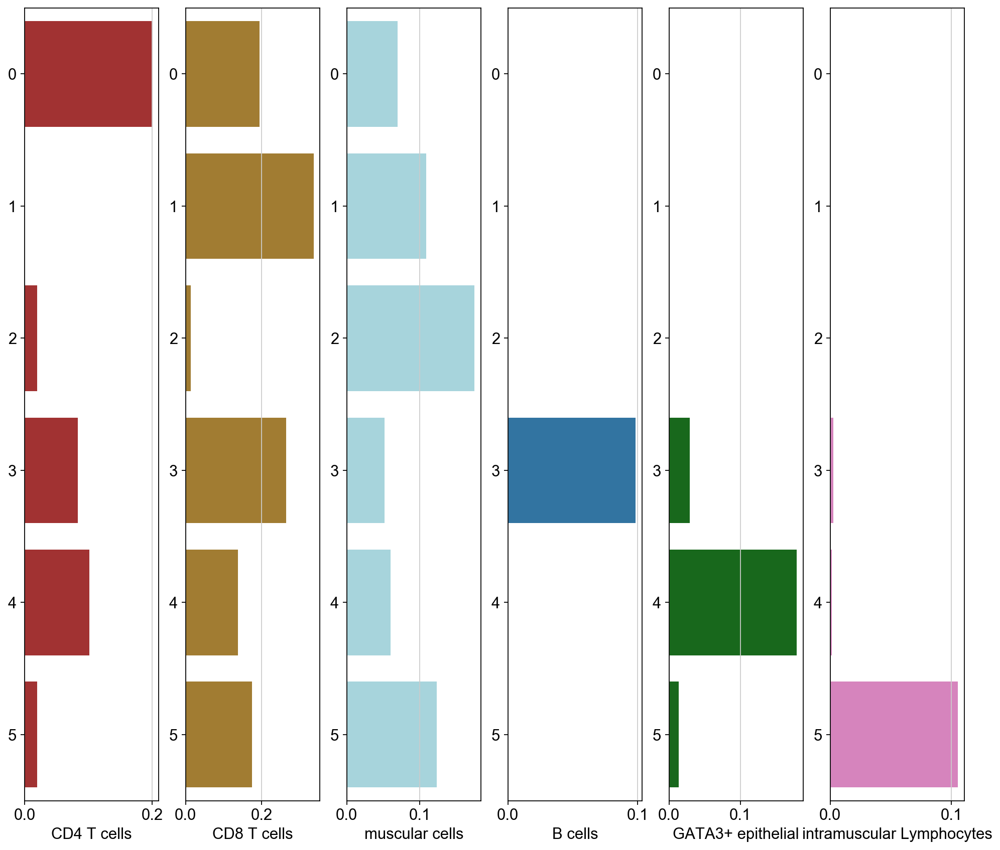

In [311]:
fig, ax = plt.subplots(ncols=6, figsize=(15,13))
sns.barplot(y=df_all_CD3.index, x=df_all_CD3['CD4 T cells'], color='#b41f1f', ax=ax[0], orient='h')
sns.barplot(y=df_all_CD3.index, x=df_all_CD3['CD8 T cells'], color='#b4821f', ax=ax[1], orient='h')
sns.barplot(y=df_all_CD3.index, x=df_all_CD3['muscular cells'], color='#9edae5', ax=ax[2], orient='h')
sns.barplot(y=df_all_CD3.index, x=df_all_CD3['B cells'], color='#1f77b4', ax=ax[3], orient='h')
sns.barplot(y=df_all_CD3.index, x=df_all_CD3['GATA3+ epithelial'], color='#0b7510', ax=ax[4], orient='h')
sns.barplot(y=df_all_CD3.index, x=df_all_CD3['intramuscular Lymphocytes'], color='#e377c2', ax=ax[5], orient='h')
#for axes in ax:
#    axes.set_xlim(0,0.35)
fig.savefig('./figures/barplots_CD3.svg')

In [296]:
adata.uns['celltype_Level_2_colors']

['#1f77b4',
 '#b41f1f',
 '#b4821f',
 '#279e68',
 '#c4d627',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#0b7510',
 '#750b73',
 '#750b0b',
 '#ad78d6',
 '#9edae5',
 '#dbdb8d']

#### Investigate T cell subsets:

In [73]:
adata_CD3_prot=adata_neighbour_CD3[:,adata_neighbour_CD3.var.feature_types=='gene_expression']
adata_CD3_prot.obs['leiden_CD3_neighbour']=adata_neighbour_CD3_noprot.obs['leiden_CD3_neighbour']

Trying to set attribute `.obs` of view, copying.


... storing 'feature_types' as categorical


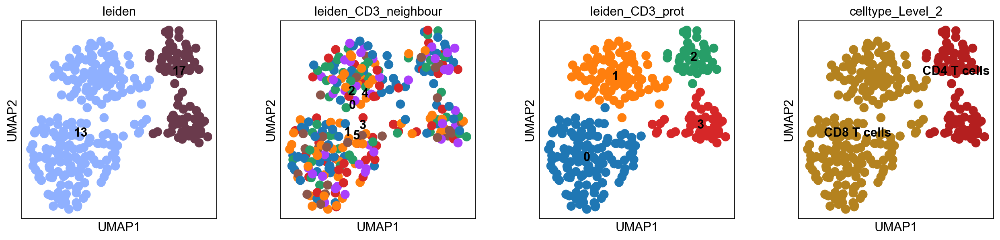

In [74]:
sc.tl.pca(adata_CD3_prot, svd_solver='arpack')
sc.pp.neighbors(adata_CD3_prot, n_neighbors=10, n_pcs=20)
sc.tl.umap(adata_CD3_prot, min_dist=1)
sc.tl.leiden(adata_CD3_prot, key_added='leiden_CD3_prot', resolution=0.3)
sc.pl.umap(adata_CD3_prot, color=['leiden','leiden_CD3_neighbour','leiden_CD3_prot','celltype_Level_2'], legend_loc='on data')

In [75]:
adata_CD3_prot.obs['T_cell_pop']='no'
adata_CD3_prot.obs.T_cell_pop[adata_CD3_prot.obs.leiden_CD3_prot=='0']='naive CD8'
adata_CD3_prot.obs.T_cell_pop[adata_CD3_prot.obs.leiden_CD3_prot=='1']='memory CD8'
adata_CD3_prot.obs.T_cell_pop[adata_CD3_prot.obs.leiden_CD3_prot=='2']='naive CD4'
adata_CD3_prot.obs.T_cell_pop[adata_CD3_prot.obs.leiden_CD3_prot=='3']='memory CD4'

... storing 'T_cell_pop' as categorical
/Users/Sebastian/miniconda3/lib/python3.7/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  rankings_gene_logfoldchanges.append(np.log2(foldchanges[global_indices]))


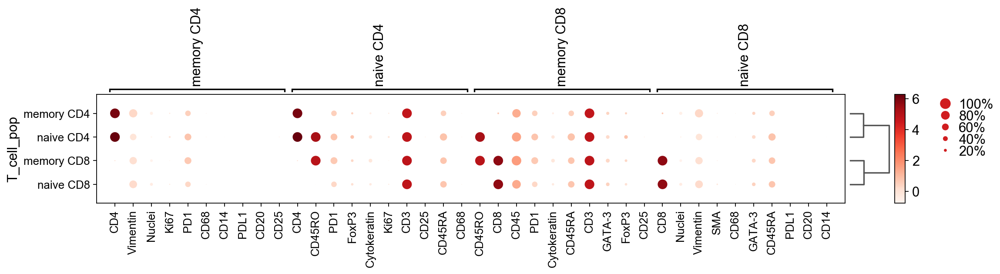

In [76]:
sc.tl.rank_genes_groups(adata_CD3_prot, 'T_cell_pop', method='wilcoxon')
sc.pl.rank_genes_groups_dotplot(adata_CD3_prot, n_genes=10)

#### Investigate CD4 T cell subsets:

In [77]:
adata_CD4_prot=adata_CD3_prot[adata_CD3_prot.obs.celltype_lymphocytes.isin(['CD4 T cells'])]

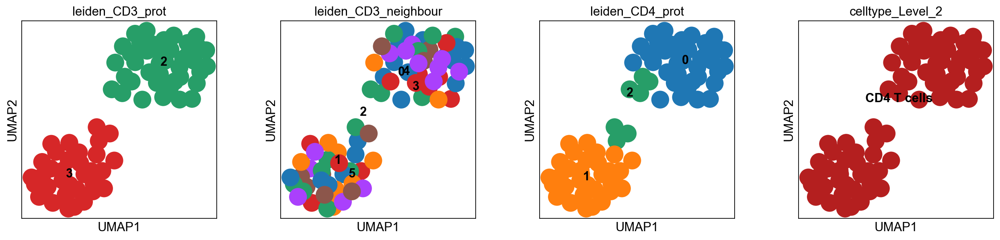

In [78]:
sc.tl.pca(adata_CD4_prot, svd_solver='arpack')
sc.pp.neighbors(adata_CD4_prot, n_neighbors=50, n_pcs=5)
sc.tl.umap(adata_CD4_prot)
sc.tl.leiden(adata_CD4_prot, key_added='leiden_CD4_prot', resolution=1)
sc.pl.umap(adata_CD4_prot, color=['leiden_CD3_prot','leiden_CD3_neighbour','leiden_CD4_prot','celltype_Level_2'], legend_loc='on data')

/Users/Sebastian/miniconda3/lib/python3.7/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  rankings_gene_logfoldchanges.append(np.log2(foldchanges[global_indices]))


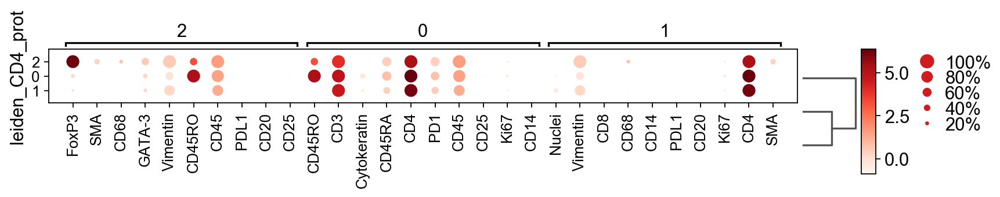

In [79]:
sc.tl.rank_genes_groups(adata_CD4_prot, 'leiden_CD4_prot', method='wilcoxon')
sc.pl.rank_genes_groups_dotplot(adata_CD4_prot, n_genes=10)

In [80]:
adata_CD3_prot.obs['T_cell_pop']=adata_CD3_prot.obs['T_cell_pop'].astype(str)
adata_CD3_prot.obs.T_cell_pop[adata_CD3_prot.obs_names.isin(adata_CD4_prot[adata_CD4_prot.obs.leiden_CD4_prot=='2'].obs_names)]='Tregs'

... storing 'T_cell_pop' as categorical


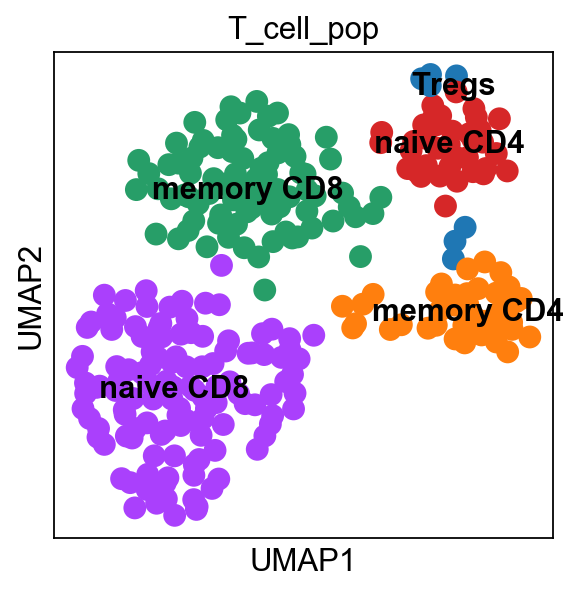

In [81]:
sc.pl.umap(adata_CD3_prot, color='T_cell_pop', legend_loc='on data')

In [82]:
adata_neighbour_CD3_noprot.obs['T_cell_pop']=adata_CD3_prot.obs.T_cell_pop

#### Replot neighborhood clusters with theire neighboring cells in the tissue:

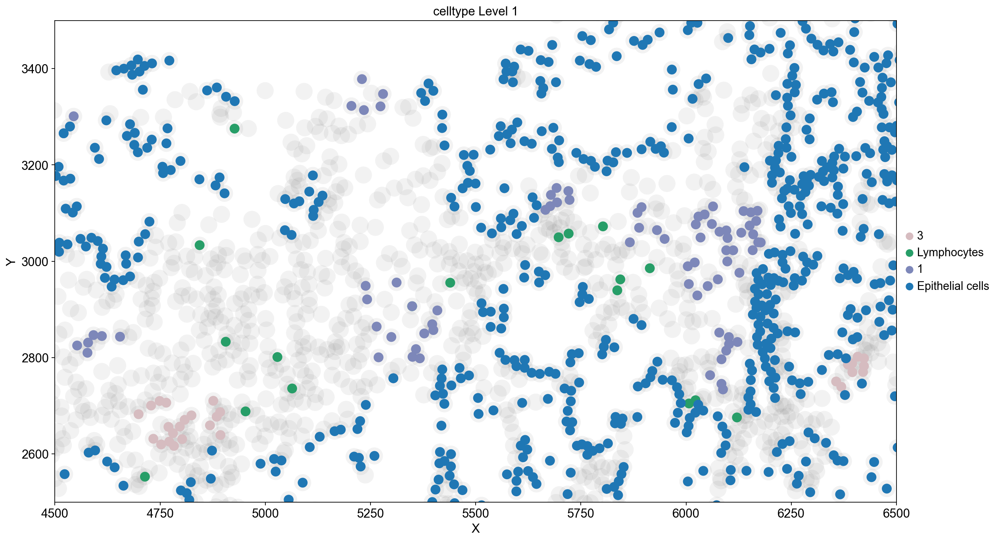

In [83]:
fig, ax = plt.subplots(figsize=(17, 10))
ax.set_xlim([4500,6500])
ax.set_ylim([2500,3500])
sc.pl.scatter(adata, 'X', 'Y', size=1500, alpha=0.1, ax=ax, show=False)
sc.pl.scatter(adata_neigbours_only[adata_neigbours_only.obs.leiden_neighbours=='3'], 'X', 'Y', color='leiden_neighbours', size=500, ax=ax, show=False)
sc.pl.scatter(adata[adata.obs.leiden=='35'], 'X', 'Y', color='celltype_Level_1', size=500, ax=ax, show=False)
sc.pl.scatter(adata_neigbours_only[adata_neigbours_only.obs.leiden_neighbours=='1'], 'X', 'Y', color='leiden_neighbours', size=500, ax=ax, show=False)
sc.pl.scatter(adata[adata.obs.celltype_Level_1=='Epithelial cells'], 'X', 'Y', color='celltype_Level_1', size=500, ax=ax, show=False)

ax.grid(False)

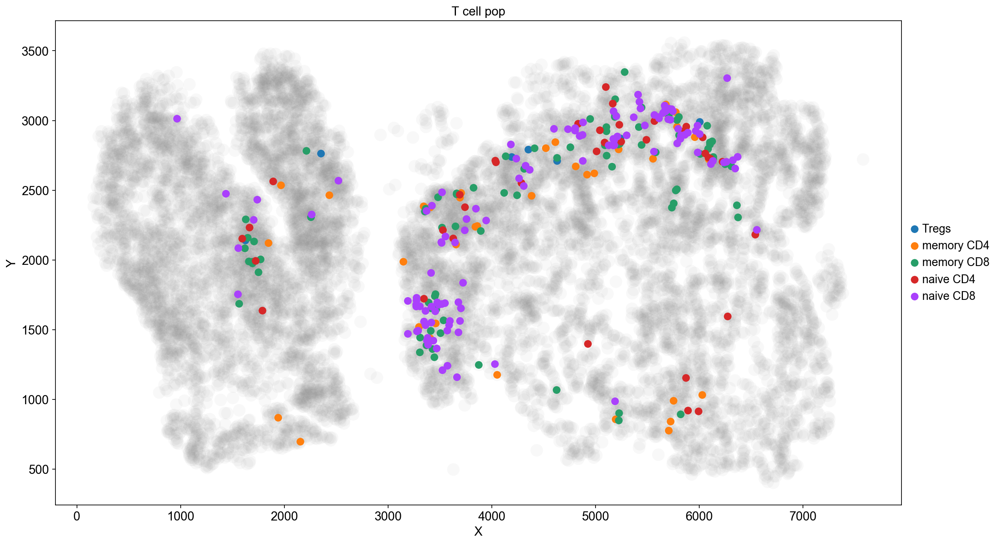

In [84]:
fig, ax = plt.subplots(figsize=(17, 10))
sc.pl.scatter(adata, 'X', 'Y', size=800, alpha=0.05, ax=ax, show=False)
sc.pl.scatter(adata_neighbour_CD3_noprot, 'X', 'Y', color='T_cell_pop', size=300, ax=ax, show=False)
ax.grid(False)

## Narrow down radius to interaction

In [85]:
cells_of_interest = ['9395','2397','2609','13019'] #cells selected from different tissue regions
x=20 #set the radius (represents a 30µm range)

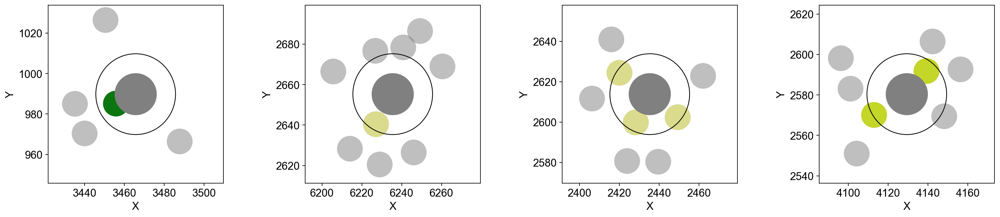

In [86]:
fig, ax = plt.subplots(ncols=4, figsize=(18, 4))
fig.tight_layout(w_pad=5)
for i, cell in enumerate(cells_of_interest):
    ax[i].set_xlim([adata.obs.loc[cell]['X']-2.2*x,adata.obs.loc[cell]['X']+2.2*x])
    ax[i].set_ylim([adata.obs.loc[cell]['Y']-2.2*x,adata.obs.loc[cell]['Y']+2.2*x])
    circle = plt.Circle((adata.obs.loc[cell]['X'], adata.obs.loc[cell]['Y']), x, edgecolor="black", facecolor='none')
    sc.pl.scatter(adata[adata.obs_names.isin(distances_completed.loc[distances_completed[cell]<=(2*x),cell].index.values.astype(str))], 'X', 'Y', size=4500, alpha=0.5, ax=ax[i], show=False)
    sc.pl.scatter(adata[adata.obs_names.isin(distances_completed.loc[distances_completed[cell]<=x,cell].index.values.astype(str))], 'X', 'Y', color='celltype_Level_2', size=4500, ax=ax[i], show=False)
    sc.pl.scatter(adata[adata.obs_names.isin([cell])], 'X', 'Y', size=12000, ax=ax[i], show=False)
    ax[i].add_artist(circle)
    ax[i].grid(False)
    ax[i].get_legend().remove()

In [149]:
distances_completed_na=distances_completed.replace(0,np.nan) #cells shouldnt be counted as their own neighbors
distances_completed_na[distances_completed_na>=x]=np.nan #exclude distances greater than the selected radius x

In [151]:
neighbours=pd.DataFrame()
for i in range(adata.obs.celltype_Level_2.nunique()):
    neighbours[i]=distances_completed_na.loc[:,adata.obs_names[adata.obs.celltype_Level_2==np.sort(adata.obs.celltype_Level_2.unique()).astype(str)[i]].values].count(axis=1)

In [152]:
neighbours=neighbours[neighbours.index.isin(adata.obs_names)]
var_data=var_data[var_data.index.isin(adata.obs_names)]

In [153]:
for i, cluster in enumerate(adata.obs.celltype_Level_2.unique()):
    neighbours.iloc[:,i]=neighbours.iloc[:,i]/(adata[adata.obs.celltype_Level_2==cluster].shape[0]/adata.shape[0])

In [154]:
neighbours.columns=np.sort(adata.obs.celltype_Level_2.unique()).astype(str)

In [155]:
#for cell in neighbours.index.astype(str).tolist():
#    phenotype=adata.obs.loc[cell].celltype_Level_2
#    neighbours.loc[int(cell),neighbours.columns==phenotype]=0

In [185]:
#Process and merge the adata.var matrix with the distance matrix
var_data.columns=adata.var_names
var_data.index=neighbours.index
neighbours.columns=np.sort(adata.obs.celltype_Level_2.unique()).astype(str)
var_data_merged=pd.concat([neighbours, var_data], axis=1)
var_data_merged=var_data_merged[var_data_merged.index.isin(adata.obs_names)]
var_data_merged.to_csv('./export/var_data_merged_interaction.csv', index=False)
adata_interaction=sc.read_csv('./export/var_data_merged_interaction.csv')
#sc.pp.normalize_total(adata_interaction, target_sum=1e4)
sc.pp.log1p(adata_interaction)
sc.pp.scale(adata_interaction, max_value=10)
adata_interaction.obs=adata_neigbours_only.obs
adata_interaction.uns=adata_neigbours_only.uns
adata_interaction.var['feature_types']='gene_expression'
adata_interaction.var['feature_types'][:adata_interaction.obs.celltype_Level_2.nunique()]='distance'

In [186]:
adata_interaction_only=adata_interaction[:,adata_interaction.var.feature_types=='distance']
adata_interaction_only.obs['n_counts'] = adata_interaction_only.X.sum(axis=1)

Trying to set attribute `.obs` of view, copying.


/Users/Sebastian/miniconda3/lib/python3.7/site-packages/numba/typed_passes.py:293: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../miniconda3/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  state.func_ir.loc))
/Users/Sebastian/miniconda3/lib/python3.7/site-packages/umap/umap_.py:1052: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
/Users/Sebastian/miniconda3/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 60 separate connected components using meta-embedding (experimental)
  n_components
... storing 'leiden_interaction_anno' as categorical


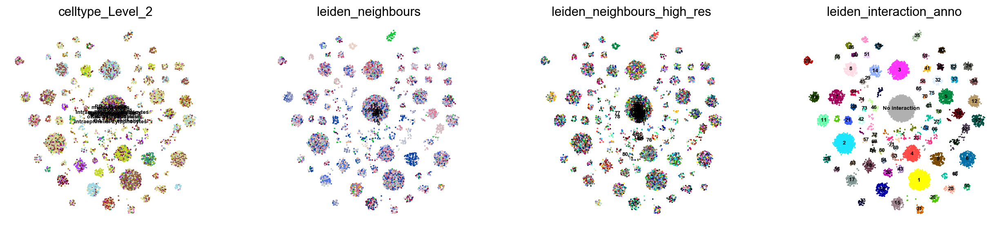

In [192]:
sc.tl.pca(adata_interaction_only, svd_solver='arpack')
sc.pp.neighbors(adata_interaction_only, n_neighbors=20, n_pcs=5)
sc.tl.umap(adata_interaction_only, min_dist=1.99)
sc.tl.leiden(adata_interaction_only, key_added='leiden_interaction', resolution=0.5)

# generate annotation for the cells without interaction
adata_interaction_only.obs['leiden_interaction_anno']=adata_interaction_only.obs['leiden_interaction'].astype(str)
adata_interaction_only.obs.leiden_interaction_anno[adata_interaction_only.obs.leiden_interaction_anno=='0']='No interaction'
adata_interaction_only.uns['leiden_interaction_anno_colors'][-1]='#b0b0b0'

sc.pl.umap(adata_interaction_only, color=['celltype_Level_2','leiden_neighbours','leiden_neighbours_high_res','leiden_interaction_anno'], legend_loc='on data', legend_fontsize=6, frameon=False)

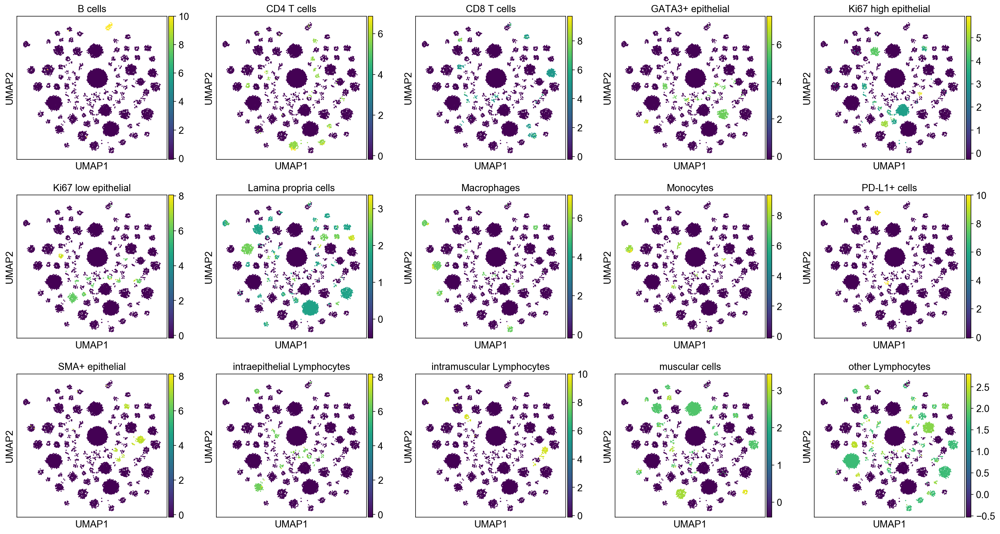

In [193]:
sc.pl.umap(adata_interaction_only, color=adata_interaction_only.var_names, ncols=5)

In [52]:
def plot_neighbours_2(cell, ax, defining_phenotype, show_only_defining=True):
    x=60
    ax.set_xlim([adata.obs.loc[cell]['X']-1.2*x,adata.obs.loc[cell]['X']+1.2*x])
    ax.set_ylim([adata.obs.loc[cell]['Y']-1.2*x,adata.obs.loc[cell]['Y']+1.2*x])
    plotdata=adata[adata.obs_names.isin(distances_completed_na.loc[distances_completed_na[cell]<=x,cell].index.values.astype(str))]
    
    if show_only_defining==True:
        sc.pl.scatter(plotdata[plotdata.obs.celltype_Level_2.values.astype(str)==defining_phenotype], 'X', 'Y', color='celltype_Level_2', size=400, ax=ax, show=False)
        sc.pl.scatter(plotdata[plotdata.obs.celltype_Level_2.values.astype(str)!=defining_phenotype], 'X', 'Y', color='celltype_Level_2', size=400, ax=ax, alpha=0.2, show=False)
    else:
        sc.pl.scatter(plotdata, 'X', 'Y', color='celltype_Level_2', size=400, ax=ax, show=False)
    
    sc.pl.scatter(adata[adata.obs_names.isin([cell])], 'X', 'Y', size=800, color='celltype_Level_2', ax=ax, show=False)
    circle = plt.Circle((adata.obs.loc[cell]['X'], adata.obs.loc[cell]['Y']), 10, edgecolor="black", facecolor='none')
    ax.add_artist(circle)
    ax.grid(False)
    ax.get_legend().remove()
    ax.set_xticklabels([])
    ax.set_xticks([])
    ax.set_yticklabels([])
    ax.set_yticks([])
    ax.set_ylabel('')
    ax.set_xlabel('')
    ax.set_title('')

In [198]:
def plot_interactions(cell, ax, defining_phenotype, show_only_defining=True):
    x=20
    ax.set_xlim([adata.obs.loc[cell]['X']-1.2*x,adata.obs.loc[cell]['X']+1.2*x])
    ax.set_ylim([adata.obs.loc[cell]['Y']-1.2*x,adata.obs.loc[cell]['Y']+1.2*x])
    plotdata=adata[adata.obs_names.isin(distances_completed_na.loc[distances_completed_na[cell]<=x,cell].index.values.astype(str))]
    
    if show_only_defining==True:
        sc.pl.scatter(plotdata[plotdata.obs.celltype_Level_2.values.astype(str)==defining_phenotype], 'X', 'Y', color='celltype_Level_2', size=1200, ax=ax, show=False)
        sc.pl.scatter(plotdata[plotdata.obs.celltype_Level_2.values.astype(str)!=defining_phenotype], 'X', 'Y', color='celltype_Level_2', size=1200, ax=ax, alpha=0.2, show=False)
    else:
        sc.pl.scatter(plotdata, 'X', 'Y', color='celltype_Level_2', size=1200, ax=ax, show=False)
    
    sc.pl.scatter(adata[adata.obs_names.isin([cell])], 'X', 'Y', size=2400, color='celltype_Level_2', ax=ax, show=False)
    circle = plt.Circle((adata.obs.loc[cell]['X'], adata.obs.loc[cell]['Y']), 6, edgecolor="black", facecolor='none')
    ax.add_artist(circle)
    ax.grid(False)
    ax.get_legend().remove()
    ax.set_xticklabels([])
    ax.set_xticks([])
    ax.set_yticklabels([])
    ax.set_yticks([])
    ax.set_ylabel('')
    ax.set_xlabel('')
    ax.set_title('')

Interaction cluster 35


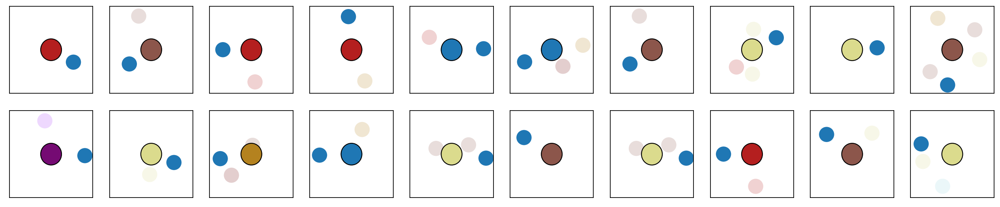

Interaction cluster 48


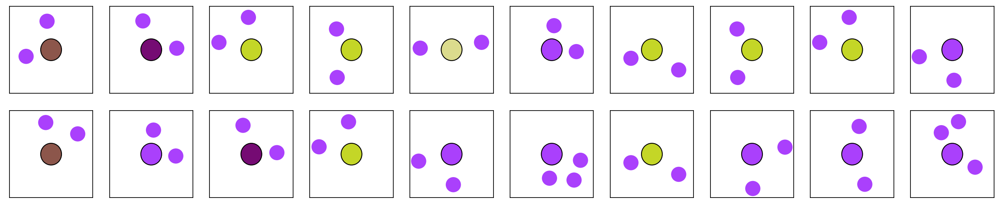

Interaction cluster 18


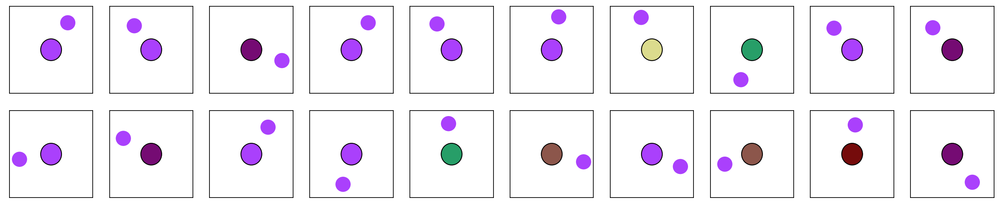

Interaction cluster 51


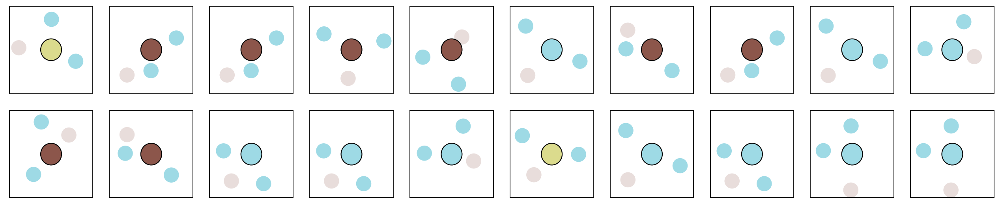

Interaction cluster 28


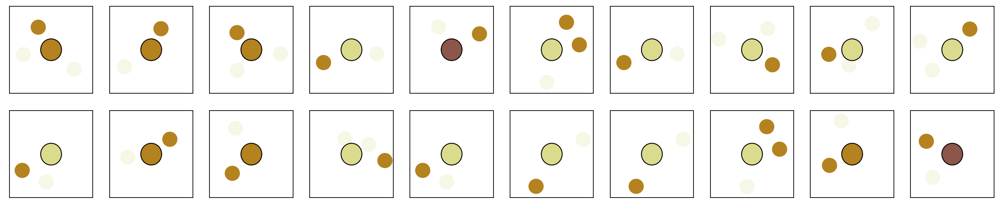

In [204]:
for j in ['35','48','18','51','28']:#np.random.choice(adata_interaction_only.obs.leiden_interaction_anno.unique().sort_values()[1:], size=5):
    print('Interaction cluster '+str(j))
    fig, ax = plt.subplots(ncols=10,nrows=2, figsize=(20,4))
    i=0
    defining_phenotype=pd.DataFrame(adata_interaction_only[adata_interaction_only.obs.leiden_interaction_anno==str(j)].X, columns=adata_interaction_only.var_names).mean().sort_values(ascending=False).index[0]
    for cell in np.random.choice(adata_interaction_only[adata_interaction_only.obs.leiden_interaction_anno==str(j)].obs_names.values, size=20):
        plot_interactions(cell, ax.reshape(-1)[i], defining_phenotype)
        i=i+1
    plt.show()

In [205]:
df_all=pd.DataFrame()
for i, j in enumerate(adata_interaction_only.obs.leiden_interaction_anno.unique()):
    df=pd.DataFrame()
    for cell in adata_interaction_only[adata_interaction_only.obs.leiden_interaction_anno==str(j)].obs_names.values:
        data=pd.DataFrame(adata.obs[adata.obs_names.isin(distances_completed_na.loc[distances_completed_na[cell]<=(2*x),cell].index.values.astype(str))]["celltype_Level_2"].value_counts())
        data=data/data[data['celltype_Level_2']>0].sum()
        df=pd.concat([df,data], axis=1)
    df_all=pd.concat([df_all,pd.DataFrame(df.mean(axis=1),columns=[str(j)])], axis=1)
df_all=df_all.T

In [207]:
df_values=pd.DataFrame()
for cluster in adata_interaction_only.obs.leiden_interaction_anno.unique():
    valuelist=[np.zeros(15)]
    for cell in adata_interaction_only[adata_interaction_only.obs.leiden_interaction_anno==cluster].obs_names.values:
        valuelist = [value+adata_interaction_only[cell].X.tolist()[0] for value in valuelist]
    valuelist=[value/adata_interaction_only[adata_interaction_only.obs.leiden_interaction_anno==cluster].shape[0] for value in valuelist]
    df_values=pd.concat([df_values,pd.DataFrame(valuelist, index=[str(cluster)]).T], axis=1)

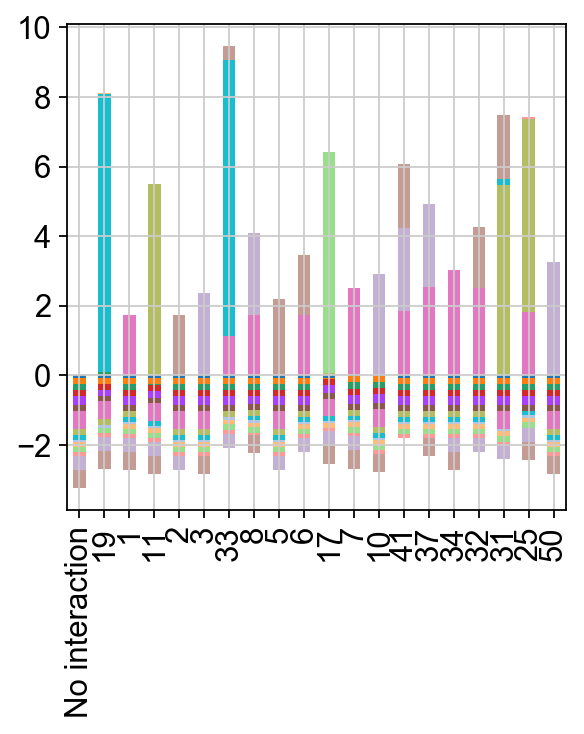

In [208]:
df_values.T[:20].plot(kind='bar', stacked=True, legend=None)

In [209]:
simpson_list=[]
for i in range(df_all.shape[0]):
    simpson_list.append(sum(n**2 for n in df_all.iloc[i]))
    
df_all.columns=df_all.columns.astype(str)
df_all['Diversity']=simpson_list
df_all=df_all.sort_values('Diversity', ascending=False)

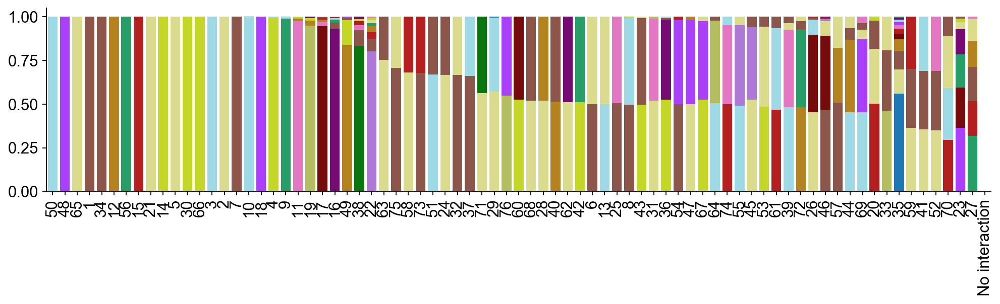

In [215]:
fig, ax = plt.subplots(ncols=77, figsize=(15,3))
for i in range (77):
    data=pd.concat([pd.DataFrame(df_all.iloc[i,:-1]),
               pd.DataFrame(adata_interaction_only.uns['celltype_Level_2_colors'].tolist(),
                            index=df_all.columns[:-1], 
                            columns=['color'])], axis=1).sort_values(df_all.index[i], ascending=False).T
    pd.DataFrame(data.iloc[0]).T.plot(kind='bar', stacked=True, legend=None, grid=False, colors=data.iloc[1], ax=ax[i], width=2)
    ax[i].axes.get_yaxis().set_visible(False)
    ax[i].spines['top'].set_visible(False)
    ax[i].spines['right'].set_visible(False)
    ax[i].spines['left'].set_visible(False)
ax[0].axes.get_yaxis().set_visible(True)
ax[0].spines['left'].set_visible(True)
plt.subplots_adjust(wspace=0, hspace=0)

In [217]:
df_members=pd.DataFrame()
for i, j in enumerate(df_all.index.values.tolist()):
    data=adata.obs[adata.obs_names.isin(adata_neigbours_only[adata_neigbours_only.obs.leiden_neighbours_high_res==str(j)].obs_names.values)].celltype_Level_2.value_counts(normalize=True)
    df_members=pd.concat([df_members,data], axis=1)   
df_members.columns=df_all.index.values.tolist()
df_members=df_members.T

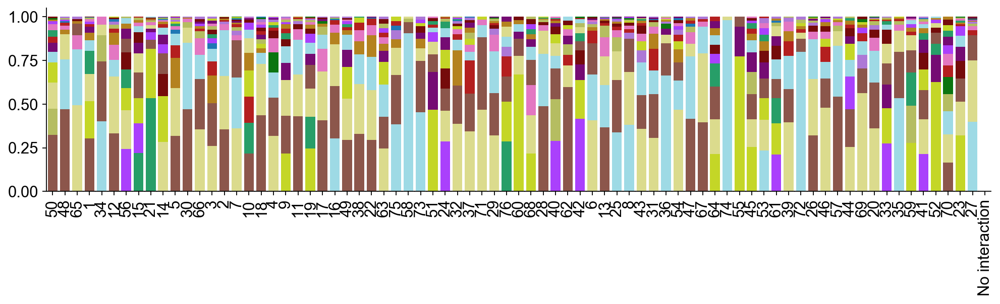

In [232]:
fig, ax = plt.subplots(ncols=77, figsize=(15,3))
for i in range (77):
    data=pd.concat([pd.DataFrame(df_members.iloc[i,:]),
               pd.DataFrame(adata_interaction_only.uns['celltype_Level_2_colors'].tolist(),
                            index=df_all.columns[:-1], 
                            columns=['color'])], axis=1, sort=True).sort_values(df_all.index[i], ascending=False).T
    pd.DataFrame(data.iloc[0]).T.plot(kind='bar', stacked=True, legend=None, grid=False, colors=data.iloc[1], ax=ax[i], width=2)
    ax[i].axes.get_yaxis().set_visible(False)
    ax[i].spines['top'].set_visible(False)
    ax[i].spines['right'].set_visible(False)
    ax[i].spines['left'].set_visible(False)
ax[0].axes.get_yaxis().set_visible(True)
ax[0].spines['left'].set_visible(True)
plt.subplots_adjust(wspace=0, hspace=0)

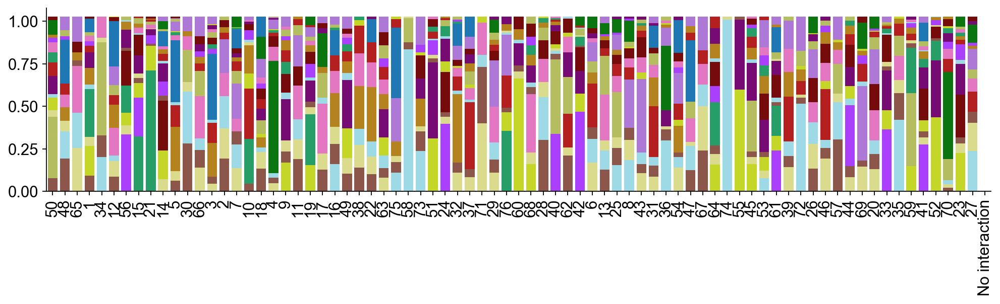

In [244]:
fig, ax = plt.subplots(ncols=77, figsize=(15,3))
for i in range (77):
    data=pd.concat([pd.DataFrame(df_members.iloc[i,:]),
               pd.DataFrame(adata_interaction_only.uns['celltype_Level_2_colors'].tolist(),
                            index=df_all.columns[:-1], 
                            columns=['color'])], axis=1, sort=True).sort_values(df_all.index[i], ascending=False).T
    for j, cluster in enumerate(data.columns):
        data.iloc[0,j]=data.iloc[0,j]/(adata[adata.obs.celltype_Level_2==cluster].shape[0]/adata.shape[0])
    pd.DataFrame(data.iloc[0]/17).T.plot(kind='bar', stacked=True, legend=None, grid=False, colors=data.iloc[1], ax=ax[i], width=2)
    ax[i].axes.get_yaxis().set_visible(False)
    ax[i].spines['top'].set_visible(False)
    ax[i].spines['right'].set_visible(False)
    ax[i].spines['left'].set_visible(False)
ax[0].axes.get_yaxis().set_visible(True)
ax[0].spines['left'].set_visible(True)
plt.subplots_adjust(wspace=0, hspace=0)

## Subgroup to CD3 positive cells

In [109]:
adata_interaction_CD3=adata_interaction[adata_interaction.obs.celltype_lymphocytes.isin(['CD4 T cells', 'CD8 T cells'])]
adata_interaction_CD3=adata_interaction_CD3[adata_interaction_CD3[: , 'CD3'].X.toarray()[:,0] >=0.5, :] 
adata_interaction_CD3=adata_interaction_CD3[:,adata_interaction_CD3.var.feature_types=='distance']
adata_interaction_CD3.obs=adata_interaction_CD3.obs.join(adata_CD3_prot.obs.T_cell_pop)

... storing 'feature_types' as categorical


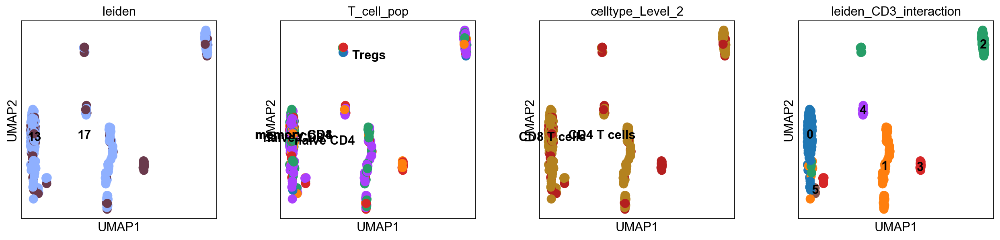

In [110]:
sc.tl.pca(adata_interaction_CD3, svd_solver='arpack')
sc.pp.neighbors(adata_interaction_CD3, n_neighbors=50, n_pcs=10)
sc.tl.umap(adata_interaction_CD3, min_dist=0.8)
sc.tl.leiden(adata_interaction_CD3, key_added='leiden_CD3_interaction', resolution=0.6)
sc.pl.umap(adata_interaction_CD3, color=['leiden','T_cell_pop','celltype_Level_2','leiden_CD3_interaction'], legend_loc='on data')

/Users/Sebastian/miniconda3/lib/python3.7/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  rankings_gene_logfoldchanges.append(np.log2(foldchanges[global_indices]))


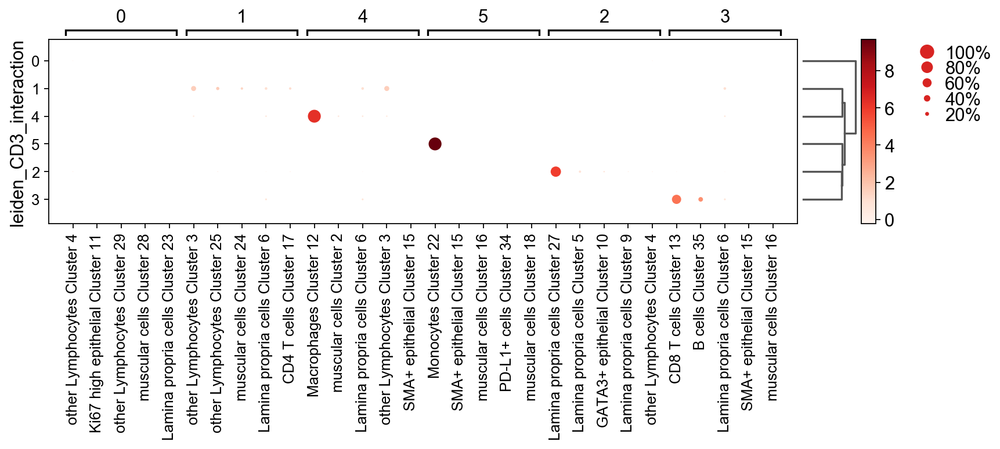

In [111]:
sc.tl.rank_genes_groups(adata_interaction_CD3, 'leiden_CD3_interaction', method='wilcoxon')
sc.pl.rank_genes_groups_dotplot(adata_interaction_CD3, n_genes=5)

#### Generate data with unprocessed number of neighbors for further plotting:

In [291]:
neighbours_for_plot=neighbours
neighbours_for_plot_CD3=neighbours_for_plot[neighbours_for_plot.index.isin(adata_neighbour_CD3_noprot.obs_names)]
neighbours_for_plot_CD3.to_csv('./export/raw_neighbours_CD3_interaction.csv')
adata_CD3_forplot = sc.read_csv('./export/raw_neighbours_CD3_interaction.csv',first_column_names=True)
adata_CD3_forplot.obs=adata_interaction_CD3.obs
adata_CD3_forplot.obs['T_cell_pop']=adata_CD3_prot.obs['T_cell_pop']

neighbours_for_plot_all=neighbours_for_plot[neighbours_for_plot.index.isin(adata.obs_names)]
neighbours_for_plot_all.to_csv('./export/raw_neighbours_all_interaction.csv')
adata_forplot = sc.read_csv('./export/raw_neighbours_all_interaction.csv',first_column_names=True)
adata_forplot.obs=adata.obs

#adata_CD3_forplot=adata_CD3_forplot[adata_CD3_forplot.X.sum(axis=1)>=0.01]
#adata_forplot=adata_forplot[adata_forplot.X.sum(axis=1)>=0.5]

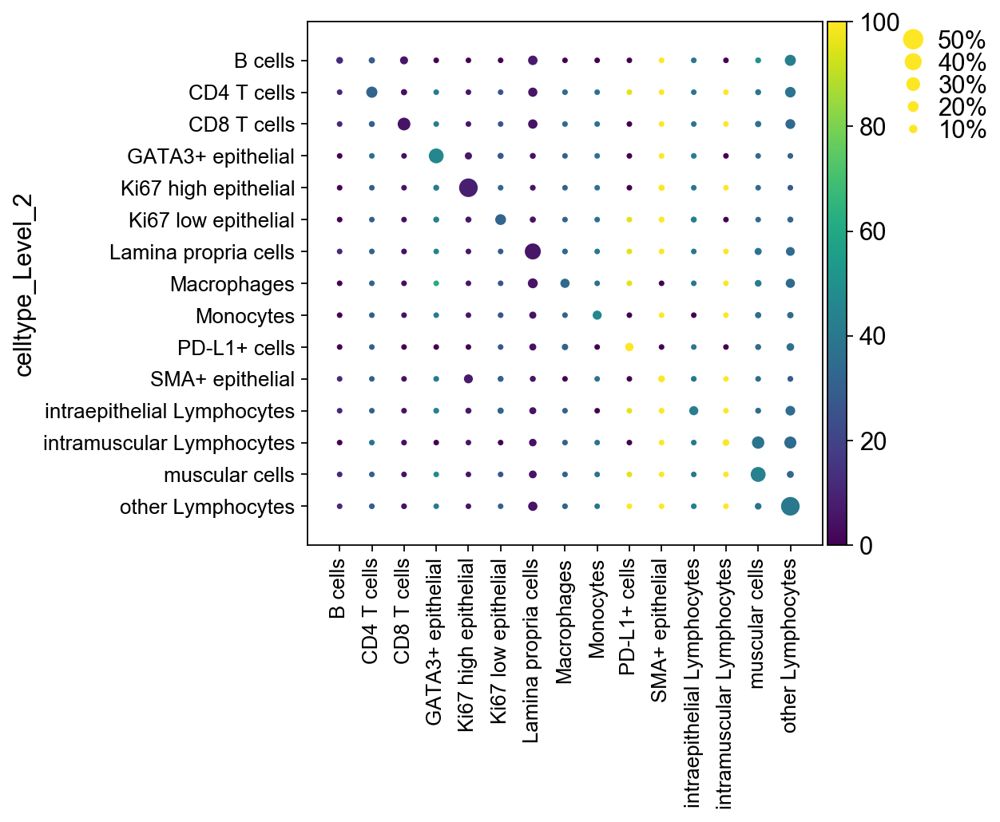

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[5.25, 0, 0.2, 0.5, 0.25])

In [292]:
sc.pl.dotplot(adata_forplot, var_names=adata_forplot.var_names, groupby='celltype_Level_2',smallest_dot=10, mean_only_expressed=True, color_map='viridis', use_raw=False, dot_max=0.5, vmax=100)

In [293]:
for i, cluster in enumerate(adata.obs.celltype_Level_2.unique()):
    neighbours.iloc[:,i]=neighbours.iloc[:,i]*(adata[adata.obs.celltype_Level_2==cluster].shape[0]/adata.shape[0])

In [294]:
neighbours_for_plot=neighbours
neighbours_for_plot_CD3=neighbours_for_plot[neighbours_for_plot.index.isin(adata_neighbour_CD3_noprot.obs_names)]
neighbours_for_plot_CD3.to_csv('./export/raw_neighbours_CD3_interaction.csv')
adata_CD3_forplot = sc.read_csv('./export/raw_neighbours_CD3_interaction.csv',first_column_names=True)
adata_CD3_forplot.obs=adata_interaction_CD3.obs
adata_CD3_forplot.obs['T_cell_pop']=adata_CD3_prot.obs['T_cell_pop']

neighbours_for_plot_all=neighbours_for_plot[neighbours_for_plot.index.isin(adata.obs_names)]
neighbours_for_plot_all.to_csv('./export/raw_neighbours_all_interaction.csv')
adata_forplot = sc.read_csv('./export/raw_neighbours_all_interaction.csv',first_column_names=True)
adata_forplot.obs=adata.obs



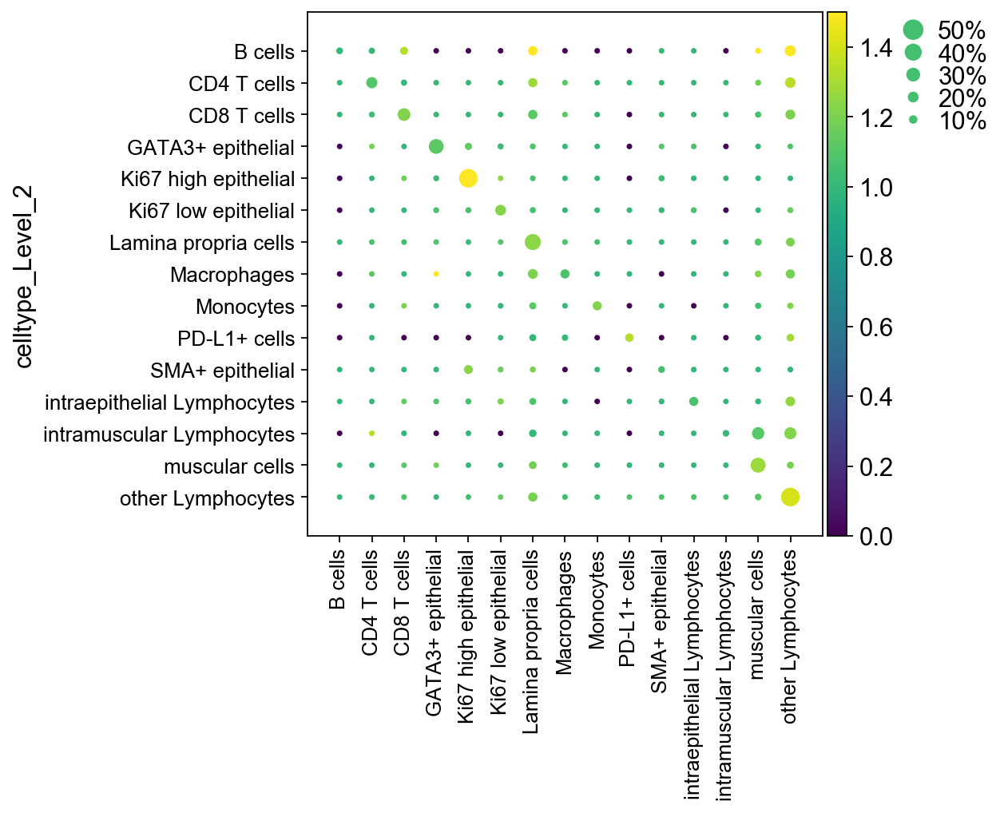

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[5.25, 0, 0.2, 0.5, 0.25])

In [301]:
sc.pl.dotplot(adata_forplot, var_names=adata_forplot.var_names, groupby='celltype_Level_2',smallest_dot=10, mean_only_expressed=True, color_map='viridis', use_raw=False, dot_max=0.5, vmax=1.5)

In [117]:
for pop in adata_CD3_forplot.obs.T_cell_pop.unique().sort_values():
    print('Population '+str(pop))
    rows = adata_CD3_forplot[adata_CD3_forplot.obs.T_cell_pop==str(pop)].shape[0]//20+1
    fig, ax = plt.subplots(ncols=20,nrows=rows, figsize=(40,rows*2))

    for i, cell in enumerate(adata_CD3_forplot[adata_CD3_forplot.obs.T_cell_pop==str(pop)].obs_names.values):
        plot_interactions(cell, ax.reshape(-1)[i])
    
    [axi.set_axis_off() for axi in ax.reshape(-1)[adata_CD3_forplot[adata_CD3_forplot.obs.T_cell_pop==str(pop)].shape[0]:]]
    plt.show()